# Capstone Project - The Battle of Neighborhoods (Week 2)

# Introduction 

This project aims to explore and compare neighborhoods in Toronto  for families who were forced to immigrate to Canada from different countries all over the world. Reasons for immigration are different, but choosing the right city to live in with a family and children is a difficult real-life problem.

# I. Discussion of the background - problem description:

Friends of mine - a couple with a son and daughter want to immigrate to Canada and someone advised them to settle down in Toronto. 
The most important aspect for them is children. Their son is 15 years old and should attend high school, the daughter is 5 years old and should go to kindergarten.
They also need to rent a house or apartment, which they can afford, and near high school and kindergarten, in a secure neighborhood. 
The neighborhood also needs recreation places such as parks for everyday jogging and popular outdoor activities for families.<br>
All analysis and a final report will be targeted at all families who are decided to move to Toronto and look for a nice place to live, not only for immigrants families.

# II.Data section

## II.1. Neighborhoods in Toronto - from wikipedia page "https://en.wikipedia.org/wiki/List_of_postal_codes_of_Canada:_M"


**1. Scrape the Wikipedia page with postal codes from Toronto and wrangle the data, clean it, and then read it into a pandas dataframe so that it is in a structured format 
dataset.**

In [1]:
from bs4 import BeautifulSoup
import requests
import re
import pandas as pd

**2. Retreiving the URL and creating a Beautiful soup object - transformation data in the table on the Wikipedia page into the pandas dataframe.**

In [2]:
# download url data from internet
url = "https://en.wikipedia.org/wiki/List_of_postal_codes_of_Canada:_M"
source = requests.get(url).text
soup = BeautifulSoup(source, 'html5lib')

# creat a new Dataframe
column_names = ['Postalcode','Borough','Neighborhood']
toronto = pd.DataFrame(columns = column_names)
toronto.head()

tables = soup.find_all('table') 
len(tables)

3

**3. Processing the cells that have an assigned borough and ignoring cells with a borough that is **Not assigned** **

In [3]:
for tr in tables[0].find_all('tr'):
    for td in tr.find_all('td'):
        postcode=td.text[1:4]
        temp=re.split(r'\(|,|\n',td.text[4:])
        borough=temp[0]
        neighborhood=temp[1].replace("/",",")
        neighborhood=neighborhood.replace(")","")        
        toronto = toronto.append({'Postalcode': postcode,'Borough': borough,'Neighborhood': neighborhood},ignore_index=True)    
               

toronto['Borough']=toronto['Borough'].replace({'Downtown TorontoStn A PO Boxes25 The Esplanade':'Downtown Toronto Stn A',
                                             'East TorontoBusiness reply mail Processing Centre969 Eastern':'East Toronto Business',
                                             'EtobicokeNorthwest':'Etobicoke Northwest','East YorkEast Toronto':'East York/East Toronto',
                                             'MississaugaCanada Post Gateway Processing Centre':'Mississauga'})        
# clean dataframe 
toronto = toronto[toronto.Borough!='Not assigned']
toronto = toronto[toronto.Borough!= 0]
toronto.reset_index(drop = True, inplace = True)

**4. If more than one neighborhood can exist in one postal code area - these two rows will be combined into one row with the neighborhoods separated with a comma as shown in row 11 in the above table.**

In [4]:
result = toronto.groupby(['Postalcode','Borough'], sort=False).agg( ', '.join)
toronto=result.reset_index()
toronto.head()

,Postalcode,Borough,Neighborhood
0,M3A,North York,Parkwoods
1,M4A,North York,Victoria Village
2,M5A,Downtown Toronto,"Regent Park , Harbourfront"
3,M6A,North York,"Lawrence Manor , Lawrence Heights"
4,M7A,Queen's Park,Ontario Provincial Government


**5. If a cell has a borough but a *Not assigned* neighborhood, then the neighborhood will be the same as the borough.**

In [5]:
toronto.loc[toronto['Neighborhood'] =='Not assigned' , 'Neighborhood'] = toronto['Borough']
toronto.head()

,Postalcode,Borough,Neighborhood
0,M3A,North York,Parkwoods
1,M4A,North York,Victoria Village
2,M5A,Downtown Toronto,"Regent Park , Harbourfront"
3,M6A,North York,"Lawrence Manor , Lawrence Heights"
4,M7A,Queen's Park,Ontario Provincial Government


**6. In the last cell we use the .shape method to print the number of rows of dataframe.**

In [6]:
toronto.shape

(103, 3)

**7. Building a dataframe of the postal code of each neighborhood along with the borough name and neighborhood name, in order to utilize the Foursquare location data, we need to get the latitude and the longitude coordinates of each neighborhood.**

In [7]:
!wget -q -O 'Geospatial_Coordinates.csv'  https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/IBMDeveloperSkillsNetwork-DS0701EN-SkillsNetwork/labs_v1/Geospatial_Coordinates.csv
toronto_coordinates = pd.read_csv('Geospatial_Coordinates.csv')
toronto_coordinates.head()

,Postal Code,Latitude,Longitude
0,M1B,43.806686,-79.194353
1,M1C,43.784535,-79.160497
2,M1E,43.763573,-79.188711
3,M1G,43.770992,-79.216917
4,M1H,43.773136,-79.239476


In [8]:
toronto_coordinates.columns=['Postalcode','Latitude','Longitude']
toronto_coordinates.head()

,Postalcode,Latitude,Longitude
0,M1B,43.806686,-79.194353
1,M1C,43.784535,-79.160497
2,M1E,43.763573,-79.188711
3,M1G,43.770992,-79.216917
4,M1H,43.773136,-79.239476


In [9]:
toronto_all = pd.merge(toronto,
                 toronto_coordinates[['Postalcode','Latitude', 'Longitude']],
                 on='Postalcode')
toronto_all

,Postalcode,Borough,Neighborhood,Latitude,Longitude
0,M3A,North York,Parkwoods,43.753259,-79.329656
1,M4A,North York,Victoria Village,43.725882,-79.315572
2,M5A,Downtown Toronto,"Regent Park , Harbourfront",43.654260,-79.360636
3,M6A,North York,"Lawrence Manor , Lawrence Heights",43.718518,-79.464763
4,M7A,Queen's Park,Ontario Provincial Government,43.662301,-79.389494
...,...,...,...,...,...
98,M8X,Etobicoke,"The Kingsway , Montgomery Road , Old Mill North",43.653654,-79.506944
99,M4Y,Downtown Toronto,Church and Wellesley,43.665860,-79.383160
100,M7Y,East Toronto Business,Enclave of M4L,43.662744,-79.321558
101,M8Y,Etobicoke,"Old Mill South , King's Mill Park , Sunnylea ,...",43.636258,-79.498509


**8. Modification of neighborhood column - not all neighborhoods (140) are in include e.g. Yonge-St.Clair - and check with https://www.zipcodesonline.com/2020/06/postal-code-of-toronto-in-2020.html**

In [10]:
import pandas as pd
data=pd.read_csv('Neighbourhood_Toronto.csv')

for i in range (0,data.shape[0],1):   
    for j in range (0,toronto_all.shape[0],1):        
        if (data.iloc[i]['Postalcode'].lstrip() in toronto_all.iloc[j]['Postalcode']):
            #print(data.iloc[i]['Postalcode'].lstrip(),"-->",toronto_all.iloc[j]['Postalcode'])                
            toronto_all.at[j,'Neighborhood']=toronto_all.iloc[j]['Neighborhood'].lstrip()+","+data.iloc[i]['Neighborhood'];


toronto_all.head(10)


,Postalcode,Borough,Neighborhood,Latitude,Longitude
0,M3A,North York,"Parkwoods,Parkwoods,Parkwoods-Donalda",43.753259,-79.329656
1,M4A,North York,"Victoria Village,Victoria Village",43.725882,-79.315572
2,M5A,Downtown Toronto,"Regent Park , Harbourfront,Harbourfront,Moss P...",43.654260,-79.360636
3,M6A,North York,"Lawrence Manor , Lawrence Heights,Briar Hill-B...",43.718518,-79.464763
4,M7A,Queen's Park,"Ontario Provincial Government,Queen's Park",43.662301,-79.389494
5,M9A,Etobicoke,"Islington Avenue,Edenbridge-Humber Valley,Humb...",43.667856,-79.532242
6,M1B,Scarborough,"Malvern , Rouge,Agincourt South-Malvern West,M...",43.806686,-79.194353
7,M3B,North York,"Don MillsNorth,Banbury-Don Mills,Don Mills",43.745906,-79.352188
8,M4B,East York,"Parkview Hill , Woodbine Gardens,O'Connor-Park...",43.706397,-79.309937
9,M5B,Downtown Toronto,"Garden District,Church-Yonge Corridor,Garden D...",43.657162,-79.378937


# II.2. Safety and crimes - from Toronto Police Service ( Public Safety Data Portal)


**1.We download data in *.csv file https://data.torontopolice.on.ca/datasets/3a1a9c98146e470e94e814b0e3a3fbca_0/explore?location=43.718404%2C-79.378190%2C11.73&showTable=true**

In [11]:
import pandas as pd
safety = pd.read_csv('Neighbourhood_Crime_Rates_2020.csv')
safety.rename(columns={'Neighbourhood': 'Neighborhood'}, inplace=True)
safety.shape
safety.head(10)

,OBJECTID,Neighborhood,Hood_ID,F2020_Population_Projection,Assault_2014,Assault_2015,Assault_2016,Assault_2017,Assault_2018,Assault_2019,...,Shootings_2020,Shooting_Rate2014,Shootings_Rate2015,Shootings_Rate2016,Shootings_Rate2017,Shootings_Rate2018,Shootings_Rate2019,Shootings_Rate2020,Shape__Area,Shape__Length
0,1,Yonge-St.Clair,97,14083,16,25,34,25,28,35,...,0,0.000000,0.000000,7.722008,0.000000,0.000000,0.000000,0.000000,1.161315e+06,5873.270507
1,2,York University Heights,27,30277,273,298,363,351,362,382,...,12,6.963789,0.000000,13.986990,34.504170,27.189610,20.102520,39.634040,1.324666e+07,18504.777616
2,3,Lansing-Westgate,38,18146,42,81,67,84,68,70,...,1,0.000000,0.000000,5.980146,0.000000,5.737564,11.245430,5.510856,5.346186e+06,11112.109419
3,4,Yorkdale-Glen Park,31,17560,106,137,175,163,178,210,...,14,19.740740,19.752440,19.700550,44.312210,61.042610,100.170900,79.726650,6.038326e+06,10079.426837
4,5,Stonegate-Queensway,16,27410,91,74,78,98,86,83,...,0,11.702290,7.788465,0.000000,3.821754,3.759257,3.702744,0.000000,7.946202e+06,11853.189803
5,6,Tam O'Shanter-Sullivan,118,29970,103,88,100,120,131,108,...,2,0.000000,10.645090,7.083658,6.980559,13.749010,6.771168,6.673340,5.422345e+06,10750.468290
6,7,The Beaches,63,23364,88,106,81,114,99,82,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,8.662509,0.000000,3.595829e+06,11275.181284
7,8,Thistletown-Beaumond Heights,3,10948,61,56,46,56,53,75,...,1,0.000000,9.414423,18.733610,18.620240,9.248982,27.545680,9.134089,3.339481e+06,10828.444269
8,9,Thorncliffe Park,55,23518,86,104,88,98,94,119,...,9,4.761905,9.353662,4.585052,9.009821,13.250880,34.695120,38.268560,3.126554e+06,7502.709320
9,10,Danforth East York,59,18427,68,55,41,78,79,85,...,0,0.000000,0.000000,0.000000,11.180050,0.000000,5.477051,0.000000,2.188598e+06,7623.857803


**2. Calculation the total number of crimes in 2014-2020 by neighbourhoods:**

In [12]:
column_list = list(safety)
print(column_list)
column_list_remove = ['OBJECTID','Hood_ID','F2020_Population_Projection', 'Assault_Rate2014', 'Assault_Rate2015', 'Assault_Rate2016', 'Assault_Rate2017',
                      'Assault_Rate2018', 'Assault_Rate2019', 'Assault_Rate2020','AutoTheft_Rate2014','AutoTheft_Rate2015', 'AutoTheft_Rate2016','AutoTheft_Rate2017',
                      'AutoTheft_Rate2018', 'AutoTheft_Rate2019', 'AutoTheft_Rate2020','BreakAndEnter_Rate2014', 'BreakAndEnter_Rate2015', 'BreakAndEnter_Rate2016',
                      'BreakAndEnter_Rate2017', 'BreakAndEnter_Rate2018', 'BreakAndEnter_Rate2019', 'BreakAndEnter_Rate2020','Robbery_Rate2014','RobberyRate_2015',
                      'Robbery_Rate2016', 'Robbery_Rate2017', 'Robbery_Rate2018', 'Robbery_Rate2019', 'Robbery_Rate2020','TheftOver_Rate2014', 'TheftOver_Rate2015',
                      'TheftOver_Rate2016', 'TheftOver_Rate2017', 'TheftOver_Rate2018', 'TheftOver_Rate2019', 'TheftOver_Rate2020','Homicide_Rate2014', 'Homicide_Rate2015',
                      'Homicide_Rate2016', 'Homicide_Rate2017', 'Homicide_Rate2018', 'Homicide_Rate2019', 'Homicide_Rate2020','Shooting_Rate2014', 'Shootings_Rate2015',
                      'Shootings_Rate2016', 'Shootings_Rate2017', 'Shootings_Rate2018', 'Shootings_Rate2019', 'Shootings_Rate2020', 'Shape__Area', 'Shape__Length']
for item in column_list_remove: 
    column_list.remove(item)
print(column_list)
safety['Number of all crimes 2014 - 2020'] = safety[column_list].sum(axis=1)
safety[['Neighborhood','Number of all crimes 2014 - 2020']].head()
safety

['OBJECTID', 'Neighborhood', 'Hood_ID', 'F2020_Population_Projection', 'Assault_2014', 'Assault_2015', 'Assault_2016', 'Assault_2017', 'Assault_2018', 'Assault_2019', 'Assault_2020', 'Assault_Rate2014', 'Assault_Rate2015', 'Assault_Rate2016', 'Assault_Rate2017', 'Assault_Rate2018', 'Assault_Rate2019', 'Assault_Rate2020', 'AutoTheft_2014', 'AutoTheft_2015', 'AutoTheft_2016', 'AutoTheft_2017', 'AutoTheft_2018', 'AutoTheft_2019', 'AutoTheft_2020', 'AutoTheft_Rate2014', 'AutoTheft_Rate2015', 'AutoTheft_Rate2016', 'AutoTheft_Rate2017', 'AutoTheft_Rate2018', 'AutoTheft_Rate2019', 'AutoTheft_Rate2020', 'BreakAndEnter_2014', 'BreakAndEnter_2015', 'BreakAndEnter_2016', 'BreakAndEnter_2017', 'BreakAndEnter_2018', 'BreakAndEnter_2019', 'BreakAndEnter_2020', 'BreakAndEnter_Rate2014', 'BreakAndEnter_Rate2015', 'BreakAndEnter_Rate2016', 'BreakAndEnter_Rate2017', 'BreakAndEnter_Rate2018', 'BreakAndEnter_Rate2019', 'BreakAndEnter_Rate2020', 'Robbery_2014', 'Robbery_2015', 'Robbery_2016', 'Robbery_2017

,OBJECTID,Neighborhood,Hood_ID,F2020_Population_Projection,Assault_2014,Assault_2015,Assault_2016,Assault_2017,Assault_2018,Assault_2019,...,Shooting_Rate2014,Shootings_Rate2015,Shootings_Rate2016,Shootings_Rate2017,Shootings_Rate2018,Shootings_Rate2019,Shootings_Rate2020,Shape__Area,Shape__Length,Number of all crimes 2014 - 2020
0,1,Yonge-St.Clair,97,14083,16,25,34,25,28,35,...,0.000000,0.000000,7.722008,0.000000,0.000000,0.000000,0.000000,1.161315e+06,5873.270507,436
1,2,York University Heights,27,30277,273,298,363,351,362,382,...,6.963789,0.000000,13.986990,34.504170,27.189610,20.102520,39.634040,1.324666e+07,18504.777616,4809
2,3,Lansing-Westgate,38,18146,42,81,67,84,68,70,...,0.000000,0.000000,5.980146,0.000000,5.737564,11.245430,5.510856,5.346186e+06,11112.109419,1120
3,4,Yorkdale-Glen Park,31,17560,106,137,175,163,178,210,...,19.740740,19.752440,19.700550,44.312210,61.042610,100.170900,79.726650,6.038326e+06,10079.426837,2476
4,5,Stonegate-Queensway,16,27410,91,74,78,98,86,83,...,11.702290,7.788465,0.000000,3.821754,3.759257,3.702744,0.000000,7.946202e+06,11853.189803,1379
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
135,136,Pleasant View,46,16856,34,45,56,54,46,51,...,0.000000,18.367720,6.139866,6.087539,6.035367,0.000000,11.865210,2.967493e+06,7944.829782,703
136,137,Wychwood,94,16037,54,72,80,54,74,69,...,0.000000,6.798097,0.000000,0.000000,6.481721,6.357279,12.471160,1.682111e+06,5435.022062,974
137,138,Leaside-Bennington,56,18627,41,30,38,38,36,32,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.784766e+06,14836.618542,732
138,139,Briar Hill-Belgravia,108,15448,79,91,80,75,91,81,...,6.781040,0.000000,6.792094,33.559300,13.254690,13.093290,6.473330,1.830325e+06,6289.707250,1210


**3. Calculation the tendancy of total number of crimes in 2019-2020**

In [13]:
column_list_2019 = ['Neighborhood','Assault_2019','AutoTheft_2019', 'BreakAndEnter_2019','Robbery_2019','TheftOver_2019','Homicide_2019','Shootings_2019']
column_list_2020 = ['Neighborhood','Assault_2020','AutoTheft_2020', 'BreakAndEnter_2020','Robbery_2020','TheftOver_2020','Homicide_2020','Shootings_2020']
safety['Number of all crimes 2019'] = safety[column_list_2019].sum(axis=1)
safety['Number of all crimes 2020'] = safety[column_list_2020].sum(axis=1)
safety['Change of all crimes 2019-2020'] = (safety['Number of all crimes 2020']-safety['Number of all crimes 2019'])/safety['Number of all crimes 2019']
safety.head()

,OBJECTID,Neighborhood,Hood_ID,F2020_Population_Projection,Assault_2014,Assault_2015,Assault_2016,Assault_2017,Assault_2018,Assault_2019,...,Shootings_Rate2017,Shootings_Rate2018,Shootings_Rate2019,Shootings_Rate2020,Shape__Area,Shape__Length,Number of all crimes 2014 - 2020,Number of all crimes 2019,Number of all crimes 2020,Change of all crimes 2019-2020
0,1,Yonge-St.Clair,97,14083,16,25,34,25,28,35,...,0.000000,0.000000,0.000000,0.000000,1.161315e+06,5873.270507,436,79,66,-0.164557
1,2,York University Heights,27,30277,273,298,363,351,362,382,...,34.504170,27.189610,20.102520,39.634040,1.324666e+07,18504.777616,4809,761,733,-0.036794
2,3,Lansing-Westgate,38,18146,42,81,67,84,68,70,...,0.000000,5.737564,11.245430,5.510856,5.346186e+06,11112.109419,1120,163,201,0.233129
3,4,Yorkdale-Glen Park,31,17560,106,137,175,163,178,210,...,44.312210,61.042610,100.170900,79.726650,6.038326e+06,10079.426837,2476,454,397,-0.125551
4,5,Stonegate-Queensway,16,27410,91,74,78,98,86,83,...,3.821754,3.759257,3.702744,0.000000,7.946202e+06,11853.189803,1379,211,209,-0.009479


# II.3. Prices of Houses in Toronto

**1. Webscraping  average sale price of houses in Toronto by neighbourhoods in May 2021 from Zolo portal** https://www.zolo.ca/toronto-real-estate/neighbourhoods <br>Becuase the portal uses Cloudflare to secure website, we must download webpage . 


In [14]:
from bs4 import BeautifulSoup
import requests
import re
import pandas as pd

# Webscraping 
# https://www.zolo.ca/toronto-real-estate/neighbourhoods
source = open("Popular_Neighbourhoods_in_Toronto_Zolo_ca.html", "r")
contents = source.read()
soup = BeautifulSoup(contents, 'html5lib')
#print(soup.prettify())

# creat a new Dataframe
column_names = ['Neighborhood', 'Average sale price on May 2021']
houses = pd.DataFrame(columns = column_names)
houses.head()
tables = soup.find_all('table') 
#len(tables)

for tr in tables[2].find_all('tr'):
    text=[]    
    for td in tr.find_all('td'):
        text.append(td.text) 
    if(len(text)!=0): 
        neighborhood=text[0]
        temp=re.split('(\d+)',neighborhood,1)          
        neighborhood=temp[-1]
        temp=re.findall(r'[A-Za-z]+|\d+\.\d+|[A-Za-z]+|\d+',text[3])
        if (len(temp)!=1):            
            if (temp[1]=='K'):
                multiply=1000.0
            else:
                multiply=1000000.0
        else:
            multiply=0.0
        avg_sale=float(temp[0])*multiply                
        houses = houses.append({'Neighborhood': neighborhood,'Average sale price on May 2021':avg_sale },ignore_index=True)   
houses.head()

,Neighborhood,Average sale price on May 2021
0,Agincourt North,826000.0
1,Agincourt South-Malvern West,820000.0
2,Alderwood,1200000.0
3,Annex,1600000.0
4,Banbury-Don Mills,1500000.0


**2. Webscraping average sale price of houses in Toronto by neighbourhoods in 2020 from portal https://www.moneysense.ca/spend/real-estate/where-to-buy-real-estate-in-2020-city-of-toronto/**


In [15]:
# download url data from internet
# By 2020
url = "https://www.moneysense.ca/spend/real-estate/where-to-buy-real-estate-in-2020-city-of-toronto/"
source = requests.get(url).text
soup = BeautifulSoup(source, 'html5lib')
#print(soup.prettify())
tables = soup.find_all('table') 
#print(len(tables))    
    
# creat a new Dataframe
column_names = ['Neighborhood', 'Average sale price 2020']
houses2 = pd.DataFrame(columns = column_names)
houses2.head()    

for tr in tables[0].find_all('tr'):
    text=[]    
    for td in tr.find_all('td'):
        text.append(td.text)    
    if(len(text)!=0):         
        neighborhood=text[3]       
        avg_sale=text[4]
        temp=re.findall(r'[A-Za-z]+|\d+\.\d+|[A-Za-z]+|\d+',text[4])
        avg_sale=float(''.join(temp))        
        houses2 = houses2.append({'Neighborhood': neighborhood,'Average sale price 2020':avg_sale },ignore_index=True)  

houses2.head()

,Neighborhood,Average sale price 2020
0,Alderwood,1012359.0
1,Moss Park,1509796.0
2,Blake-Jones,1241262.0
3,Mount Pleasant East,1594740.0
4,Yonge-St. Clair,2095964.0


**3. Building a dataframe of the postal code of each neighborhood along with the borough name and neighborhood name, in order to utilize in Folium map.**

In [16]:
houses_all = pd.merge(houses,
                 houses2[['Neighborhood','Average sale price 2020']],
                 on='Neighborhood')
houses_all

,Neighborhood,Average sale price on May 2021,Average sale price 2020
0,Agincourt North,826000.0,831826.0
1,Agincourt South-Malvern West,820000.0,831826.0
2,Alderwood,1200000.0,1012359.0
3,Annex,1600000.0,2095964.0
4,Banbury-Don Mills,1500000.0,1187598.0
...,...,...,...
136,Wychwood,1700000.0,2095964.0
137,Yonge-Eglinton,1700000.0,1672260.0
138,Yonge-St. Clair,2000000.0,2095964.0
139,York University Heights,805000.0,828052.0


**4. Calculation the tendancy of change in Average sale price from 2020 to May 2021**

In [17]:
houses_all['Change of Average sale price 2020-2021'] = (houses_all['Average sale price on May 2021']-houses_all['Average sale price 2020'])/houses_all['Average sale price 2020']
houses_all.head()

,Neighborhood,Average sale price on May 2021,Average sale price 2020,Change of Average sale price 2020-2021
0,Agincourt North,826000.0,831826.0,-0.007004
1,Agincourt South-Malvern West,820000.0,831826.0,-0.014217
2,Alderwood,1200000.0,1012359.0,0.185350
3,Annex,1600000.0,2095964.0,-0.236628
4,Banbury-Don Mills,1500000.0,1187598.0,0.263054


# II.3. School ranking for Secondary schools in Toronto 

**1. We download data from Fraser Institute for secondary schools in Toronto**

In [18]:
from bs4 import BeautifulSoup
import requests
import re
import pandas as pd
# download url data from internet
# url = "https://www.tdsb.on.ca/Find-your/School/Secondary"
source1 = open("Fraser Institute - School Ranking1.html", "r")
source2 = open("Fraser Institute - School Ranking2.html", "r")
source3 = open("Fraser Institute - School Ranking3.html", "r")
contents1 = source1.read()
contents2 = source2.read()
contents3 = source3.read()
#beautifulSoupText = BeautifulSoup(contents, 'lxml')
soup1 = BeautifulSoup(contents1, 'html5lib')
soup2 = BeautifulSoup(contents2, 'html5lib')
soup3 = BeautifulSoup(contents3, 'html5lib')
#print(soup.prettify())   
# creat a new Dataframe
column_names = ['School Name', 'Score 2018-2019']
schools = pd.DataFrame(columns = column_names)


tables1 = soup1.find_all('table') 
tables2 = soup2.find_all('table') 
tables3 = soup3.find_all('table') 
#len(tables)


def appending_school(table,schools):
    for tr in table.find_all('tr'):
        text=[]    
        for td in tr.find_all('td'):
            text.append(td.text)                
        if(len(text)!=0): 
            school=text[0]        
            score=text[1]            
            schools = schools.append({'School Name':school, 'Score 2018-2019':score },ignore_index=True) 
    return schools


schools1=appending_school(tables1[2],schools)
schools2=appending_school(tables2[2],schools1)
schools3=appending_school(tables3[2],schools2)
schools=schools3
schools['Post code']=''
schools


,School Name,Score 2018-2019,Post code
0,A Y Jackson,8.1,
1,Agincourt,8.1,
2,Albert Campbell,6.5,
3,Archbishop Romero,3.5,
4,Bendale,0,
...,...,...,...
104,Winston Churchill,3.1,
105,Woburn,5.4,
106,York Memorial,5.1,
107,York Mills,8.1,


**2. We have only school name and score - so we need to get school addreses. We exctrac some data from Toronto District School Board.**

In [19]:
# TDSB schools
from bs4 import BeautifulSoup
import requests
import re
import pandas as pd

# download url data from internet
url = "https://www.tdsb.on.ca/Find-your/School/Secondary"
source = requests.get(url).text
soup = BeautifulSoup(source, 'html5lib')
#print(soup.prettify())

# creat a new Dataframe
column_names = ['School Name','Post code']
school_addr = pd.DataFrame(columns = column_names)
school_addr.head()

ul_class = soup.find_all('ul',{'id': 'SchoolSearchResults'}) 
for tag in ul_class:
    tdTags = tag.find_all('li')
    for tag in tdTags:
        temp=re.split(r'\(|,|\n',tag.text)      
        text=[temp[0],temp[5],temp[6]]; 
        if (text[1]!=' ON'):
            text1=[text[1][i:i+4] for i in range(0, len(text[1]), 4)]            
            school=text[0]
            post_code=text1[0]
        else :
            text1=[text[2][i:i+4] for i in range(0, len(text[2]), 4)]            
            school=text[0]
            post_code=text1[0]
        school_addr = school_addr.append({'School Name':school, 'Post code':post_code },ignore_index=True)               

school_addr.head()

,School Name,Post code
0,A Y Jackson Secondary School,M2H
1,Agincourt Collegiate Institute,M1S
2,Albert Campbell Collegiate Institute,M1V
3,ALPHA II Alternative School,M6H
4,Alternative Scarborough Education 1,M1P


**3. We also exctrac some data from Toronto Catholic District School Board.**<br> Some schools have differnet names - so we must correct it.

In [20]:
from bs4 import BeautifulSoup
import requests
import re
import pandas as pd
import numpy as np 

# download url data from internet
url = "https://www.tcdsb.org/school/Alphabeticalschooldirectory/Pages/default.aspx"
source = requests.get(url).text
soup = BeautifulSoup(source, 'html5lib')
#print(soup.prettify())
# creat a new Dataframe
column_names = ['School Name','Post code']
school_addr2 = pd.DataFrame(columns = column_names)
school_addr2.head()
tables = soup.find_all('table') 
len(tables)


for tr in tables[2].find_all('tr'):
    text=[]    
    for td in tr.find_all('td'):
        text.append(td.text)
    if(len(text)!=0):         
        if(text[2]!='Elementary'):
            temp=re.split(r' ON ',text[3])     
            temp=re.split(r' ',temp[1])            
            post_code=temp[0]            
            if (len(post_code)>3):
                post_code = post_code[:-3]                        
            school=text[1]            
            if (school=='St John Paul II'):
                school='Pope John Paul II'                
            elif (school=='St Mother Teresa Catholic Academy'):
                school='Blessed Mother Teresa'
            elif (school=='Cardinal Carter Academy (Sr)'):                
                school='Cardinal Carter-Arts'
            elif (school=='Cardinal Carter Academy (Sr)'):                
                school='Cardinal Carter-Arts'
            elif (school=='Michael Power/St Joseph'):
                school='Michael Power/St. Joseph'
            elif (school=='St Basil-The-Great'):
                 school='St. Basil The Great'
            elif (school=='St Joseph College'):
                school='St. Joseph\'s '
            elif (school=='St Joseph Morrow Park'):
                school='St. Josephs Morrow Park'
            elif (school=='St Mary Catholic Academy'):
                school='St. Mary\'s'
            elif (school=='St Michael Choir (Sr)'):
                school='St. Michael\'s Choir'
            elif (school=='St Patrick Secondary'):
                school='St. Patrick'            
            ch_text=re.split(r' ',school)                       
            if  (ch_text[0]=='Fr'):
                 ch_text[0]='Father'            
            elif (ch_text[0]=='Msgr'):
                ch_text[0]='Monsignor'                                    
            school= ' '.join(ch_text)            
            school_addr2 = school_addr2.append({'School Name':school, 'Post code':post_code},ignore_index=True)   

school_addr2.head()

,School Name,Post code
0,St Anne Catholic Academy (Sr),M2N
1,Bishop Allen Academy,M8Y
2,Bishop Marrocco/Thomas Merton,M6P
3,Brebeuf,M2M
4,St. Basil The Great,M9M


**4. Now we merge all data frames schools, school_addr and school_addr2 to one - schools**

In [21]:
for i in range (0,schools.shape[0],1):
    for j in range (0,school_addr.shape[0],1):
         if (schools.iloc[i][0] in school_addr.iloc[j,0]):
            schools.at[i,'Post code']= school_addr.iloc[j][1].lstrip()
        
for i in range (0,schools.shape[0],1):
    for j in range (0,school_addr2.shape[0],1):
         if (schools.iloc[i][0] in school_addr2.iloc[j,0]):
            schools.at[i,'Post code']= school_addr2.iloc[j][1].lstrip()
        
schools

,School Name,Score 2018-2019,Post code
0,A Y Jackson,8.1,M2H
1,Agincourt,8.1,M1S
2,Albert Campbell,6.5,M1V
3,Archbishop Romero,3.5,
4,Bendale,0,
...,...,...,...
104,Winston Churchill,3.1,M1P
105,Woburn,5.4,M1G
106,York Memorial,5.1,M9P
107,York Mills,8.1,M3B


**5. We must now correct and clean dataframe - schools**

In [22]:
schools['Post code'].replace('', np.nan, inplace=True)
schools.dropna(subset=['Post code'], inplace=True)
schools.reset_index(drop=True,inplace=True)
schools['Score 2018-2019'] = pd.to_numeric(schools['Score 2018-2019'])
schools

,School Name,Score 2018-2019,Post code
0,A Y Jackson,8.1,M2H
1,Agincourt,8.1,M1S
2,Albert Campbell,6.5,M1V
3,Birchmount Park,3.4,M1N
4,Bishop Allen,7.4,M8Y
...,...,...,...
88,William Lyon Mackenzie,8.5,M3H
89,Winston Churchill,3.1,M1P
90,Woburn,5.4,M1G
91,York Memorial,5.1,M9P


# II.4. Merging all data - crimes, house priceses and secondary schools score and Toronto neigghbourhoods - into one data frame 

**1. Merging all data - crimes, house priceses and secondary schools score and Toronto neigghbourhoods**

In [23]:
toronto_all['Number of all crimes 2014 - 2020']=''
for i in range (0,safety.shape[0],1):    
    for j in range (0,toronto_all.shape[0],1):
            if (safety.iloc[i]['Neighborhood'].lstrip() in toronto_all.iloc[j][2]):
                toronto_all.at[j,'Number of all crimes 2014 - 2020']=safety.iloc[i][104]
                
toronto_all['School Score 2018-2019']=''

for i in range (0,schools.shape[0],1):
    for j in range (0,toronto_all.shape[0],1):        
        if (schools.iloc[i]['Post code'].lstrip() == toronto_all.iloc[j][0].lstrip()):            
            toronto_all.at[j,'School Score 2018-2019']=schools.iloc[i][1]
            
toronto_all['Average sale price - now']=''
for i in range (0,houses.shape[0],1):
    for j in range (0,toronto_all.shape[0],1):        
            if (houses.iloc[i]['Neighborhood'].lstrip() in toronto_all.iloc[j][2]):
                toronto_all.at[j,'Average sale price - now']=houses.iloc[i][1]

toronto_all.head()

,Postalcode,Borough,Neighborhood,Latitude,Longitude,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now
0,M3A,North York,"Parkwoods,Parkwoods,Parkwoods-Donalda",43.753259,-79.329656,2014,6,1e+06
1,M4A,North York,"Victoria Village,Victoria Village",43.725882,-79.315572,1306,,918000
2,M5A,Downtown Toronto,"Regent Park , Harbourfront,Harbourfront,Moss P...",43.654260,-79.360636,5970,,860000
3,M6A,North York,"Lawrence Manor , Lawrence Heights,Briar Hill-B...",43.718518,-79.464763,1210,3,848000
4,M7A,Queen's Park,"Ontario Provincial Government,Queen's Park",43.662301,-79.389494,,,


**2. Clean and remove empty rows ( no avaiable data)**



In [24]:
toronto_all.replace('', np.nan, inplace=True)
toronto_all.dropna(inplace=True)
toronto_all.reset_index(drop=True,inplace=True)
toronto_all


,Postalcode,Borough,Neighborhood,Latitude,Longitude,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now
0,M3A,North York,"Parkwoods,Parkwoods,Parkwoods-Donalda",43.753259,-79.329656,2014.0,6.0,1000000.0
1,M6A,North York,"Lawrence Manor , Lawrence Heights,Briar Hill-B...",43.718518,-79.464763,1210.0,3.0,848000.0
2,M9A,Etobicoke,"Islington Avenue,Edenbridge-Humber Valley,Humb...",43.667856,-79.532242,729.0,7.3,1800000.0
3,M1B,Scarborough,"Malvern , Rouge,Agincourt South-Malvern West,M...",43.806686,-79.194353,3051.0,5.5,707000.0
4,M3B,North York,"Don MillsNorth,Banbury-Don Mills,Don Mills",43.745906,-79.352188,1402.0,8.1,1500000.0
5,M5B,Downtown Toronto,"Garden District,Church-Yonge Corridor,Garden D...",43.657162,-79.378937,7877.0,9.4,754000.0
6,M1C,Scarborough,"Rouge Hill , Port Union , Highland Creek,Cente...",43.784535,-79.160497,2448.0,5.9,1300000.0
7,M3C,North York,"Don MillsSouth,Flemingdon Park",43.725900,-79.340923,1375.0,5.9,606000.0
8,M4C,East York,"Woodbine Heights,Danforth,Woodbine Heights,Woo...",43.695344,-79.318389,459.0,5.3,1100000.0
9,M9C,Etobicoke,"Eringate , Bloordale Gardens , Old Burnhamthor...",43.643515,-79.577201,518.0,5.5,1000000.0


# III Metodology

## III.1 Analysis safety neigborhoods in Toronto 

### III.1.1 Ten most safety neigbourhoods in 2014-2020

In [25]:
sorted_safety = pd.DataFrame(safety, columns = ['Neighborhood','Number of all crimes 2014 - 2020'])
sorted_safety = sorted_safety.sort_values(by=['Number of all crimes 2014 - 2020'], ascending=True)
sorted_safety = sorted_safety.head(10)

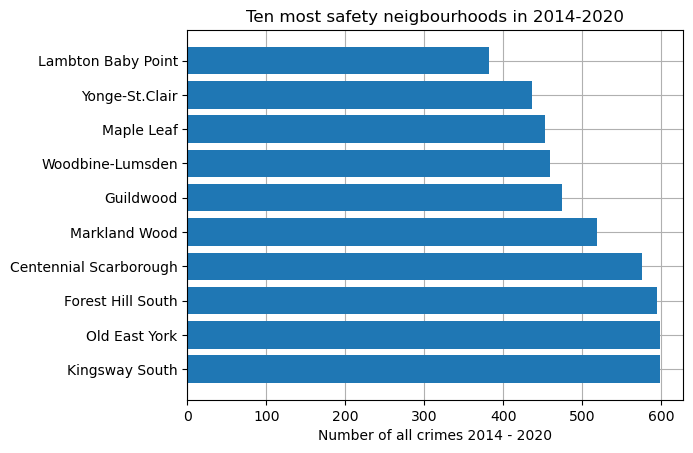

In [26]:
# Set the figure size - handy for larger output
from matplotlib import pyplot as plt
plt.rcdefaults()
fig, ax = plt.subplots()
ax.barh(sorted_safety['Neighborhood'],sorted_safety['Number of all crimes 2014 - 2020'], align='center')
ax.set_yticks(sorted_safety['Neighborhood'])
ax.set_yticklabels(sorted_safety['Neighborhood'])
ax.invert_yaxis()  # labels read top-to-bottom
ax.set_xlabel('Number of all crimes 2014 - 2020')
ax.set_title('Ten most safety neigbourhoods in 2014-2020')
ax.grid()
ax.set_axisbelow(True)




### III.1.2 Ten most dangers neigbourhoods in 2014-2020

In [27]:
sorted_safety = safety.sort_values(by=['Number of all crimes 2014 - 2020'], ascending=False)
sorted_safety = sorted_safety[['Neighborhood','Number of all crimes 2014 - 2020']].head(10)

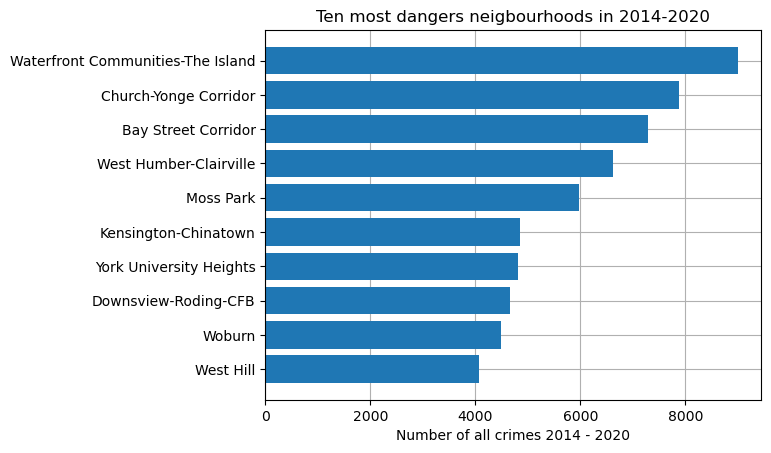

In [28]:
# Set the figure size - handy for larger output
from matplotlib import pyplot as plt
plt.rcdefaults()
fig, ax = plt.subplots()
ax.barh(sorted_safety['Neighborhood'],sorted_safety['Number of all crimes 2014 - 2020'], align='center')
ax.set_yticks(sorted_safety['Neighborhood'])
ax.set_yticklabels(sorted_safety['Neighborhood'])
ax.invert_yaxis()  # labels read top-to-bottom
ax.set_xlabel('Number of all crimes 2014 - 2020')
ax.set_title('Ten most dangers neigbourhoods in 2014-2020')
ax.grid()
ax.set_axisbelow(True)

In [29]:
#!pip install folium==0.5.0
import folium # map rendering library
import json # library to handle JSON files
import numpy as np
import pandas as pd

get_ipython().magic(u'matplotlib inline')


In [30]:
# create map of Toronto Neighbourhoods (FSAs) using retrived latitude and longitude values
map_toronto = folium.Map(location=[43.653963, -79.387207], zoom_start=11)
ontario_geo = "Neighbourhood_Crime_Rates_2020.geojson"
map_toronto.choropleth(geo_data=ontario_geo,
    data = safety,
    columns=['Neighborhood','Number of all crimes 2014 - 2020'],
    key_on='feature.properties.Neighbourhood',
    fill_color='YlOrRd',
    fill_opacity=0.7, 
    line_opacity=0.7,
    legend_name='Number of all crimes 2014 - 2020')   
    

map_toronto

## III.1.3 The tendency of all crimes 2019-2020

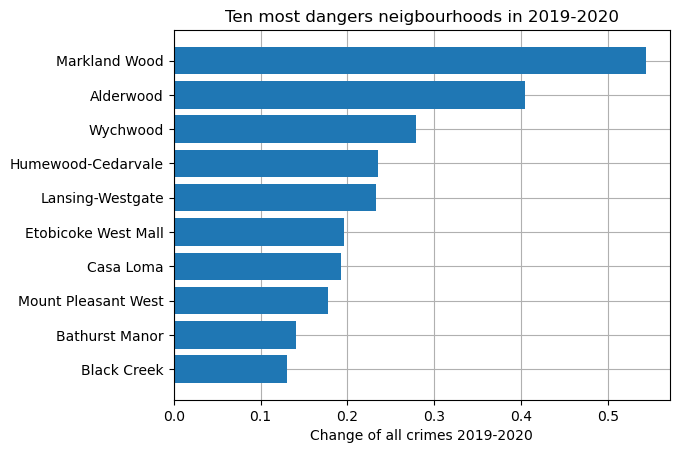

In [31]:
sorted_safety = safety.sort_values(by=['Change of all crimes 2019-2020'], ascending=False)
sorted_safety = sorted_safety[['Neighborhood','Change of all crimes 2019-2020']].head(10)
# Set the figure size - handy for larger output
from matplotlib import pyplot as plt
plt.rcdefaults()
fig, ax = plt.subplots()
ax.barh(sorted_safety['Neighborhood'],sorted_safety['Change of all crimes 2019-2020'], align='center')
ax.set_yticks(sorted_safety['Neighborhood'])
ax.set_yticklabels(sorted_safety['Neighborhood'])
ax.invert_yaxis()  # labels read top-to-bottom
ax.set_xlabel('Change of all crimes 2019-2020')
ax.set_title('Ten most dangers neigbourhoods in 2019-2020')
ax.grid()
ax.set_axisbelow(True)

In [32]:
# create map of Toronto Neighbourhoods (FSAs) using retrived latitude and longitude values
map_toronto = folium.Map(location=[43.653963, -79.387207], zoom_start=11)
ontario_geo = "Neighbourhood_Crime_Rates_2020.geojson"
map_toronto.choropleth(geo_data=ontario_geo,
    data = safety,
    columns=['Neighborhood','Change of all crimes 2019-2020'],                      
    key_on='feature.properties.Neighbourhood',
    fill_color='GnBu',
    fill_opacity=0.7, 
    line_opacity=0.7,
    legend_name='Change of all crimes 2019-2020')   

#for lat, lon, poi, cluster in zip(toronto_merged['Latitude'], toronto_merged['Longitude'], toronto_merged['Neighborhood'], toronto_merged['Cluster Labels']):

#    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
   
map_toronto

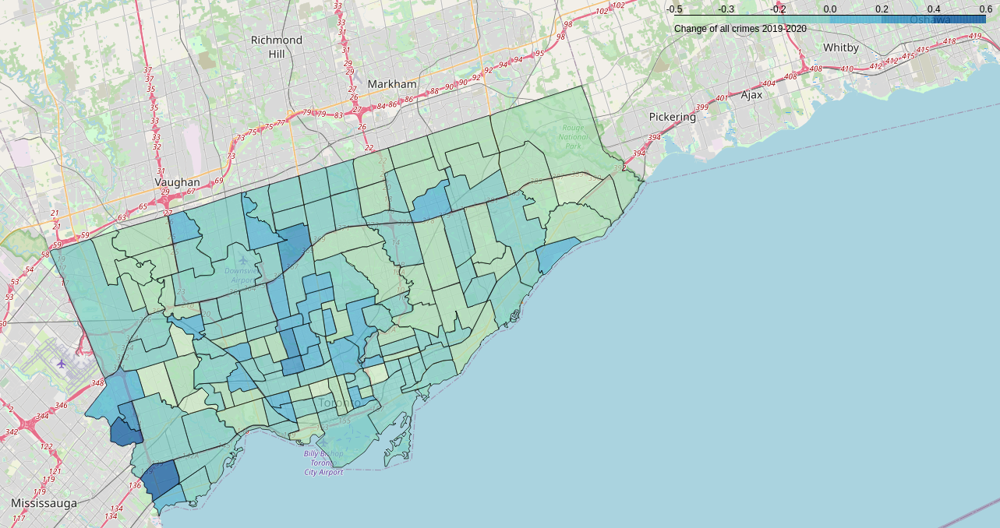

## III.2 Analysis of house prices by neigborhoods in Toronto in 2020 - May 2021

### III.2.1 Ten neighbourhoods with lowest average sale price now (May 2021)

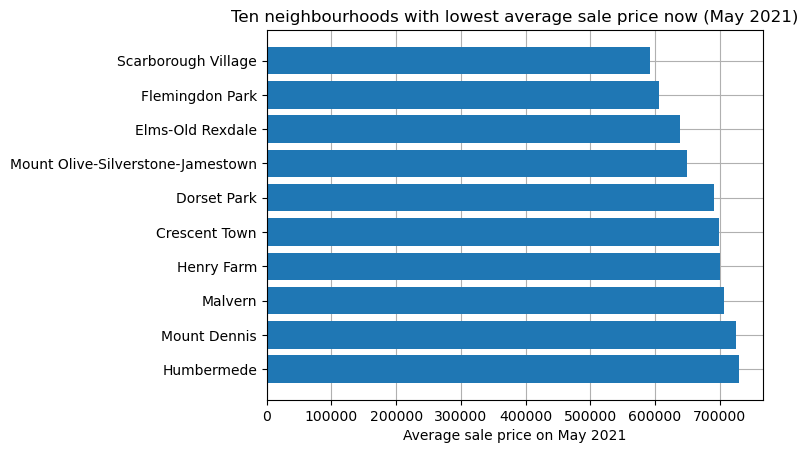

In [33]:
houses_2021 = houses_all.sort_values(by=['Average sale price on May 2021'], ascending=True)
houses_2021  = houses_2021[['Neighborhood','Average sale price on May 2021']].head(10)
# Set the figure size - handy for larger output
from matplotlib import pyplot as plt
plt.rcdefaults()
fig, ax = plt.subplots()
ax.barh(houses_2021['Neighborhood'],houses_2021['Average sale price on May 2021'], align='center')
ax.set_yticks(houses_2021['Neighborhood'])
ax.set_yticklabels(houses_2021['Neighborhood'])
ax.invert_yaxis()  # labels read top-to-bottom
ax.set_xlabel('Average sale price on May 2021')
ax.set_title('Ten neighbourhoods with lowest average sale price now (May 2021)')
ax.grid()
ax.set_axisbelow(True)

## III.2.2 Ten neighbourhoods with the highest average sale price now (May 2021)

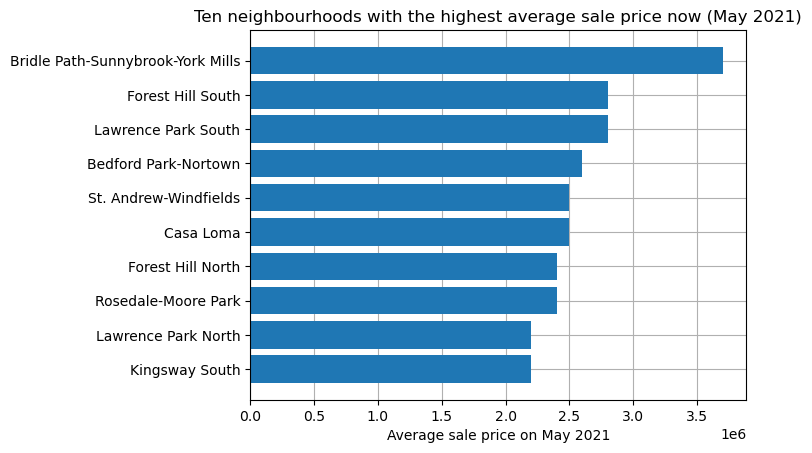

In [34]:
houses_2021 = houses_all.sort_values(by=['Average sale price on May 2021'], ascending=False)
houses_2021  = houses_2021[['Neighborhood','Average sale price on May 2021']].head(10)
# Set the figure size - handy for larger output
from matplotlib import pyplot as plt
plt.rcdefaults()
fig, ax = plt.subplots()
ax.barh(houses_2021['Neighborhood'],houses_2021['Average sale price on May 2021'], align='center')
ax.set_yticks(houses_2021['Neighborhood'])
ax.set_yticklabels(houses_2021['Neighborhood'])
ax.invert_yaxis()  # labels read top-to-bottom
ax.set_xlabel('Average sale price on May 2021')
ax.set_title('Ten neighbourhoods with the highest average sale price now (May 2021)')
ax.grid()
ax.set_axisbelow(True)

In [35]:
# create map of Toronto Neighbourhoods (FSAs) using retrived latitude and longitude values
map_toronto = folium.Map(location=[43.653963, -79.387207], zoom_start=11)
ontario_geo = "Neighbourhood_Crime_Rates_2020.geojson"
map_toronto.choropleth(geo_data=ontario_geo,
    data = houses_all,
    columns=['Neighborhood','Average sale price on May 2021'],                      
    key_on='feature.properties.Neighbourhood',
    fill_color='YlOrRd',
    fill_opacity=0.7, 
    line_opacity=0.7,
    legend_name='Average sale price on May 2021')   
    
map_toronto

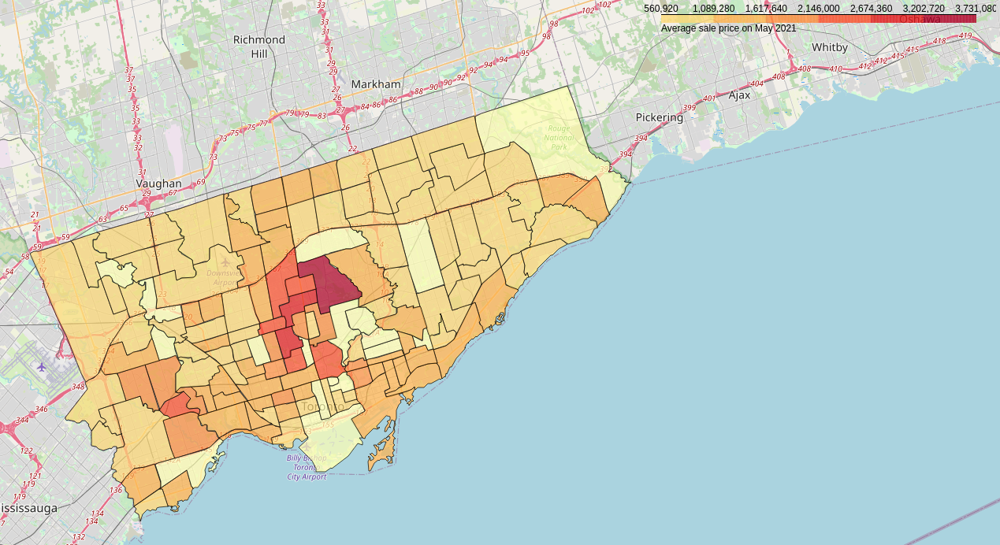

## III.2.2 Change of Avg house price from 2020 to May 2021

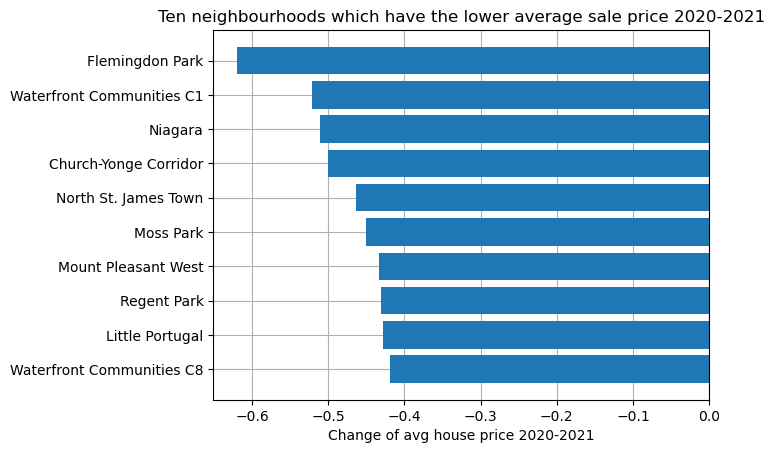

In [36]:
houses_2021 = houses_all.sort_values(by=['Change of Average sale price 2020-2021'], ascending=True)
houses_2021  = houses_2021[['Neighborhood','Change of Average sale price 2020-2021']].head(10)
# Set the figure size - handy for larger output
from matplotlib import pyplot as plt
plt.rcdefaults()
fig, ax = plt.subplots()
ax.barh(houses_2021['Neighborhood'],houses_2021['Change of Average sale price 2020-2021'], align='center')
ax.set_yticks(houses_2021['Neighborhood'])
ax.set_yticklabels(houses_2021['Neighborhood'])
ax.invert_yaxis()  # labels read top-to-bottom
ax.set_xlabel('Change of avg house price 2020-2021')
ax.set_title('Ten neighbourhoods which have the lower average sale price 2020-2021')
ax.grid()
ax.set_axisbelow(True)

In [37]:
# create map of Toronto Neighbourhoods (FSAs) using retrived latitude and longitude values
map_toronto = folium.Map(location=[43.653963, -79.387207], zoom_start=11)
ontario_geo = "Neighbourhood_Crime_Rates_2020.geojson"
map_toronto.choropleth(geo_data=ontario_geo,
    data = houses_all,
    columns=['Neighborhood','Change of Average sale price 2020-2021'],                      
    key_on='feature.properties.Neighbourhood',
    fill_color='PuOr',
    fill_opacity=0.7, 
    line_opacity=0.7,
    legend_name='Change of Average sale price 2019-2020')   
    
map_toronto

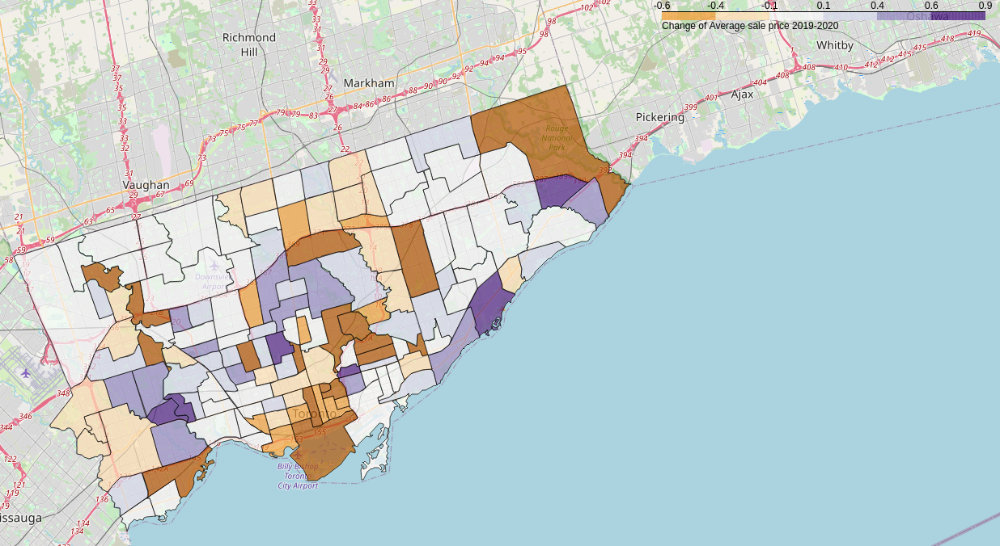

## III. 3 Map of neighborhoods with secondary schools (according to a score) 

In [39]:
# create map of Toronto Neighbourhoods (FSAs) using retrived latitude and longitude values
map_toronto = folium.Map(location=[43.6534817, -79.3839347], zoom_start=11) 
ontario_geo = "Toronto2.geojson"
map_toronto.choropleth(geo_data=ontario_geo,
    data = schools,
    columns=['Post code','Score 2018-2019'],                 
    key_on='feature.properties.CFSAUID',
    fill_color='YlOrRd',
    fill_opacity=0.7, 
    line_opacity=0.7,
    legend_name='Secondary Schools Score 2018-2019')   
    
map_toronto

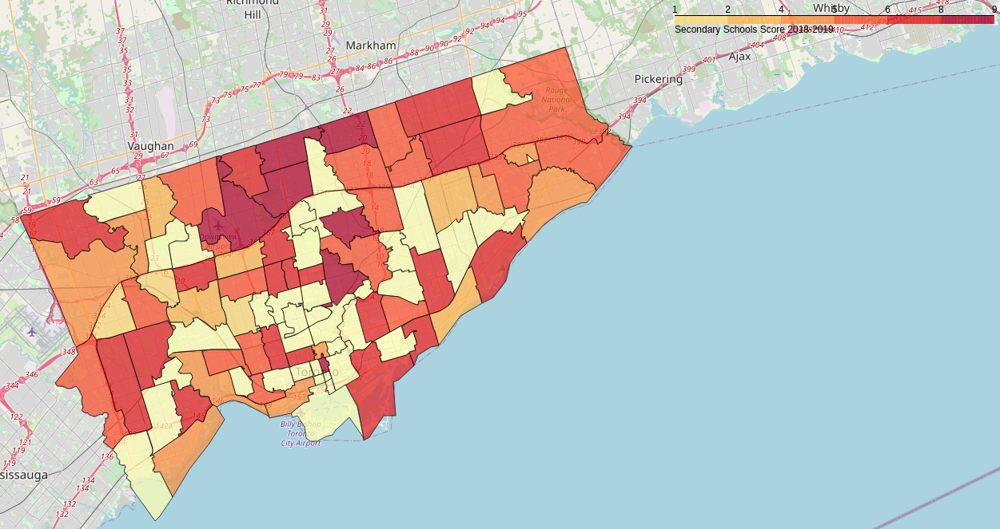

## III. 4 Clustering using Crimes, score of secondary schools amd AVG price of houses 

**1. We transform all data value to set from 0 to 1**

In [41]:
import pandas as pd
from sklearn import preprocessing

#x = df.values #returns a numpy array
x=toronto_all[['Number of all crimes 2014 - 2020','School Score 2018-2019','Average sale price - now']]
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
df = pd.DataFrame(x_scaled)
df.columns = ['Number of all crimes 2014 - 2020','School Score 2018-2019','Average sale price - now']
df.head()

,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now
0,0.217745,0.613636,0.203187
1,0.110474,0.272727,0.127490
2,0.046298,0.761364,0.601594
3,0.356104,0.556818,0.057271
4,0.136091,0.852273,0.452191


**2. Because some values has negative impact - we change them substractin values from 1**

In [42]:
df_mod = pd.DataFrame(df, columns = ['Number of all crimes 2014 - 2020','School Score 2018-2019','Average sale price - now'])
df_mod['Number of all crimes 2014 - 2020']=1-df['Number of all crimes 2014 - 2020']
df_mod['Average sale price - now']=1-df['Average sale price - now']
df_mod.head()

,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now
0,0.782255,0.613636,0.796813
1,0.889526,0.272727,0.872510
2,0.953702,0.761364,0.398406
3,0.643896,0.556818,0.942729
4,0.863909,0.852273,0.547809


In [43]:
toronto_onehot = pd.DataFrame()  
toronto_onehot['Neighborhood'] = toronto_all['Neighborhood']
toronto_onehot[['Number of all crimes 2014 - 2020','School Score 2018-2019','Average sale price - now']]=df_mod[['Number of all crimes 2014 - 2020','School Score 2018-2019','Average sale price - now']]
toronto_onehot = toronto_onehot[['Neighborhood', 'Number of all crimes 2014 - 2020','School Score 2018-2019','Average sale price - now']]
toronto_onehot.head()

,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now
0,"Parkwoods,Parkwoods,Parkwoods-Donalda",0.782255,0.613636,0.796813
1,"Lawrence Manor , Lawrence Heights,Briar Hill-B...",0.889526,0.272727,0.872510
2,"Islington Avenue,Edenbridge-Humber Valley,Humb...",0.953702,0.761364,0.398406
3,"Malvern , Rouge,Agincourt South-Malvern West,M...",0.643896,0.556818,0.942729
4,"Don MillsNorth,Banbury-Don Mills,Don Mills",0.863909,0.852273,0.547809


**3. We make additional data frame with data frame toronto_onehot in order to use in clustering**

In [44]:
toronto_onehot_old=toronto_onehot.copy()
toronto_onehot_old.head()

,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now
0,"Parkwoods,Parkwoods,Parkwoods-Donalda",0.782255,0.613636,0.796813
1,"Lawrence Manor , Lawrence Heights,Briar Hill-B...",0.889526,0.272727,0.872510
2,"Islington Avenue,Edenbridge-Humber Valley,Humb...",0.953702,0.761364,0.398406
3,"Malvern , Rouge,Agincourt South-Malvern West,M...",0.643896,0.556818,0.942729
4,"Don MillsNorth,Banbury-Don Mills,Don Mills",0.863909,0.852273,0.547809


**4. We will use unsupervised learning K-means algorithm to cluster the boroughs. K-Means algorithm is one of the most common cluster method of unsupervised learning.
But first, we will run K-Means to cluster the boroughs with k=3** 

In [47]:
# import k-means from clustering stage
from sklearn.cluster import KMeans

# set number of clusters
kclusters = 5

toronto_grouped_clustering = toronto_onehot.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(toronto_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([2, 1, 0, 2, 0, 3, 0, 2, 2, 2], dtype=int32)

**5. Now we use Elbow Method using yellowbrick library to analyze the K-Means and get optimum k of the K-Means.**

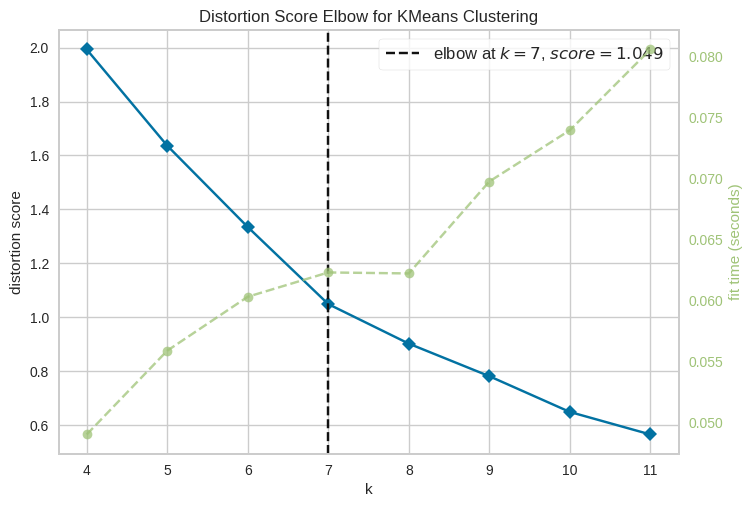

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [48]:
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs

from yellowbrick.cluster import KElbowVisualizer


# Instantiate the clustering model and visualizer
model = KMeans(n_clusters=kclusters, random_state=0).fit(toronto_grouped_clustering)
visualizer = KElbowVisualizer(model, k=(4,12))

visualizer.fit(toronto_grouped_clustering)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure


In [49]:
# import k-means from clustering stage
from sklearn.cluster import KMeans

# set number of clusters
kclusters = 7

toronto_grouped_clustering = toronto_onehot.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(toronto_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([2, 6, 0, 3, 0, 5, 0, 2, 1, 1], dtype=int32)

**6. Let's add the clusters to our data for each neighborhood.**

In [50]:
# add clustering labels
toronto_onehot.insert(0, 'Cluster Labels', kmeans.labels_)
toronto_merged = toronto_all
toronto_merged = pd.merge(toronto_all,
                 toronto_onehot[['Neighborhood','Cluster Labels']],
                 on='Neighborhood')
toronto_merged.head() 

,Postalcode,Borough,Neighborhood,Latitude,Longitude,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels
0,M3A,North York,"Parkwoods,Parkwoods,Parkwoods-Donalda",43.753259,-79.329656,2014.0,6.0,1000000.0,2
1,M6A,North York,"Lawrence Manor , Lawrence Heights,Briar Hill-B...",43.718518,-79.464763,1210.0,3.0,848000.0,6
2,M9A,Etobicoke,"Islington Avenue,Edenbridge-Humber Valley,Humb...",43.667856,-79.532242,729.0,7.3,1800000.0,0
3,M1B,Scarborough,"Malvern , Rouge,Agincourt South-Malvern West,M...",43.806686,-79.194353,3051.0,5.5,707000.0,3
4,M3B,North York,"Don MillsNorth,Banbury-Don Mills,Don Mills",43.745906,-79.352188,1402.0,8.1,1500000.0,0


**7. Let's visualize the resulting clusters on map**

In [51]:
!pip install geopy
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe
address = 'Toronto, ON'

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

geolocator = Nominatim(user_agent="to_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Toronoto are {}, {}.'.format(latitude, longitude))

# create map of Toronto Neighbourhoods (FSAs) using retrived latitude and longitude values
map_toronto = folium.Map(location=[43.6534817, -79.3839347], zoom_start=11) 
ontario_geo = "Toronto2.geojson"
map_toronto.choropleth(geo_data=ontario_geo,
    data = schools,
    columns=['Post code','Score 2018-2019'],                 
    key_on='feature.properties.CFSAUID',
    fill_color='YlOrRd',
    fill_opacity=0.7, 
    line_opacity=0.7,
    legend_name='Secondary Schools Score 2018-2019' )   
    
#map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)
# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]


# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(toronto_merged['Latitude'], toronto_merged['Longitude'], toronto_merged['Neighborhood'], toronto_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_toronto)    
 
    
    
map_toronto

DEPRECATION: Python 2.7 reached the end of its life on January 1st, 2020. Please upgrade your Python as Python 2.7 is no longer maintained. pip 21.0 will drop support for Python 2.7 in January 2021. More details about Python 2 support in pip, can be found at https://pip.pypa.io/en/latest/development/release-process/#python-2-support
Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/usr/bin/python -m pip install --upgrade pip' command.
The geograpical coordinate of Toronoto are 43.6534817, -79.3839347.


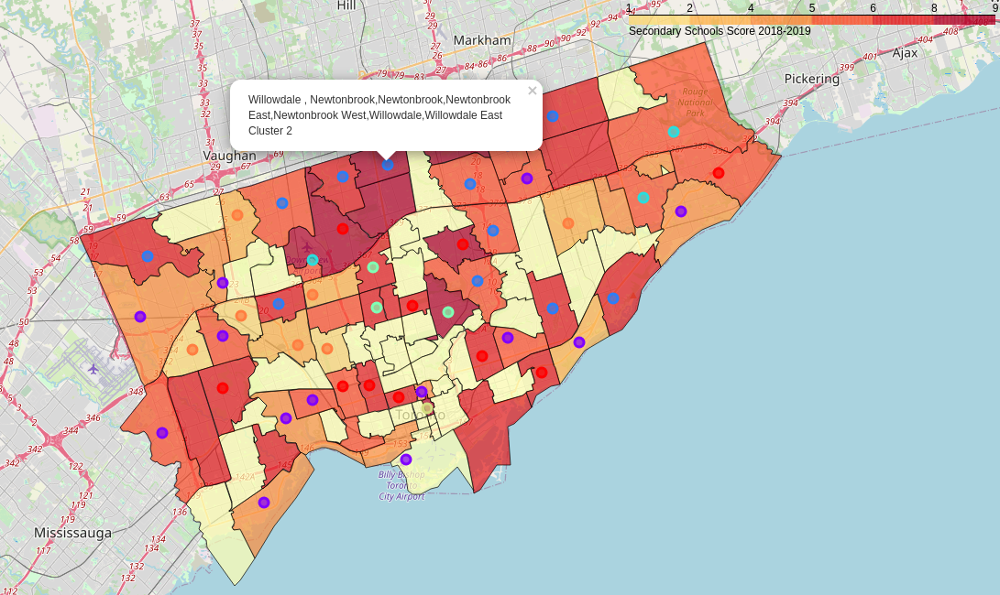

**8. Examine Clusters and determine the best Neighborhoods .**

Cluster 0

In [52]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 0, toronto_merged.columns[[1] +[2]+ list(range(5, toronto_merged.shape[1]))]]

,Borough,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels
2,Etobicoke,"Islington Avenue,Edenbridge-Humber Valley,Humb...",729.0,7.3,1800000.0,0
4,North York,"Don MillsNorth,Banbury-Don Mills,Don Mills",1402.0,8.1,1500000.0,0
6,Scarborough,"Rouge Hill , Port Union , Highland Creek,Cente...",2448.0,5.9,1300000.0,0
11,East Toronto,"The Beaches,East End-Danforth,The Beaches",2207.0,6.8,1500000.0,0
15,Downtown Toronto,"Christie,Christie,Palmerston-Little Italy,Wych...",974.0,7.3,1700000.0,0
17,North York,"Bathurst Manor , Wilson Heights , Downsview No...",940.0,8.5,1500000.0,0
18,West Toronto,"Dufferin , Dovercourt Village,Dovercourt Villa...",1132.0,6.4,1500000.0,0
21,East York/East Toronto,"The Danforth East,Blake-Jones,Broadview North...",739.0,7.3,1300000.0,0
35,Central Toronto,"Davisville North,Davisville North,Yonge-Eglinton",922.0,7.1,1700000.0,0
40,Downtown Toronto,"University of Toronto , Harbord,Harbord,Univer...",1764.0,7.2,1200000.0,0


Cluster 1

In [53]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 1, toronto_merged.columns[[1] + [2]+list(range(5, toronto_merged.shape[1]))]]

,Borough,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels
8,East York,"Woodbine Heights,Danforth,Woodbine Heights,Woo...",459.0,5.3,1100000.0,1
9,Etobicoke,"Eringate , Bloordale Gardens , Old Burnhamthor...",518.0,5.5,1000000.0,1
10,Scarborough,"Guildwood , Morningside , West Hill,Guildwood,...",1393.0,4.1,820000.0,1
29,North York,"Humberlea , Emery,Emery,Humberlea,Humbermede,P...",1101.0,4.7,730000.0,1
30,Scarborough,"Birch Cliff , Cliffside West,Birch Cliff,Birch...",1980.0,3.4,1300000.0,1
36,West Toronto,"High Park , The Junction South,High Park,High ...",1345.0,5.4,1100000.0,1
37,Etobicoke,"Westmount,Humber Heights-Westmount,Kingsview V...",623.0,5.1,763000.0,1
41,West Toronto,"Runnymede , Swansea,Kingsway South,Lambton Bab...",382.0,3.9,1500000.0,1
42,Scarborough,"Clarks Corners , Tam O'Shanter , Sullivan,Clar...",1617.0,5.2,901000.0,1
44,Downtown Toronto,"CN Tower , King and Spadina , Railway Lands , ...",733.0,4.1,806000.0,1


Cluster 2

In [54]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 2, toronto_merged.columns[[1]+[2] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels
0,North York,"Parkwoods,Parkwoods,Parkwoods-Donalda",2014.0,6.0,1000000.0,2
7,North York,"Don MillsSouth,Flemingdon Park",1375.0,5.9,606000.0,2
16,North York,"Hillcrest Village,Bayview Woods-Steeles,Hillcr...",920.0,8.1,898000.0,2
19,North York,"Fairview , Henry Farm , Oriole,Don Valley Vill...",703.0,6.3,1000000.0,2
20,North York,"Northwood Park , York University,Northwood Par...",1764.0,6.0,805000.0,2
23,Scarborough,"Golden Mile , Clairlea , Oakridge,Clairlea,Cla...",1958.0,7.8,892000.0,2
24,North York,"North Park , Maple Leaf Park , Upwood Park,Map...",453.0,6.9,1200000.0,2
25,Scarborough,"Cliffside , Cliffcrest , Scarborough Village W...",1459.0,7.1,592000.0,2
26,North York,"Willowdale , Newtonbrook,Newtonbrook,Newtonbro...",1110.0,8.1,918000.0,2
38,North York,"WillowdaleWest,Westminster-Branson,Willowdale ...",1098.0,7.2,1200000.0,2


Cluster 3

In [55]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 3, toronto_merged.columns[[1] +[2]+ list(range(5, toronto_merged.shape[1]))]]

,Borough,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels
3,Scarborough,"Malvern , Rouge,Agincourt South-Malvern West,M...",3051.0,5.5,707000.0,3
13,Scarborough,"Woburn,Woburn",4496.0,5.4,804000.0,3
22,North York,"DownsviewEast ,Downsview-Roding-CFB",4654.0,5.6,908000.0,3


Cluster 4

In [56]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 4, toronto_merged.columns[[1] +[2]+ list(range(5, toronto_merged.shape[1]))]]

,Borough,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels
14,East York,"Leaside,Leaside,Leaside-Bennington",732.0,8.7,2000000.0,4
27,North York,"Bedford Park , Lawrence Manor East,Bedford Par...",1468.0,6.8,2600000.0,4
32,Central Toronto,"Roselawn,Englemount-Lawrence,Forest Hill North...",1485.0,7.7,2400000.0,4


Cluster 5

In [57]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 5, toronto_merged.columns[[1] +[2]+ list(range(5, toronto_merged.shape[1]))]]

,Borough,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels
5,Downtown Toronto,"Garden District,Church-Yonge Corridor,Garden D...",7877.0,9.4,754000.0,5


Cluster 6

In [58]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 6, toronto_merged.columns[[1] +[2]+ list(range(5, toronto_merged.shape[1]))]]

,Borough,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels
1,North York,"Lawrence Manor , Lawrence Heights,Briar Hill-B...",1210.0,3.0,848000.0,6
12,York,"Caledonia-Fairbanks,Caledonia Fairbanks,Caledo...",674.0,0.7,1000000.0,6
28,York,"Del Ray , Mount Dennis , Keelsdale and Silvert...",1427.0,2.4,725000.0,6
31,North York,"DownsviewNorthwest,Black Creek",2727.0,2.4,765000.0,6
33,York,"Weston,Weston",2309.0,2.0,791000.0,6
34,Scarborough,"Dorset Park , Wexford Heights , Scarborough To...",2473.0,3.1,691000.0,6
39,Etobicoke,"Kingsview Village , St. Phillips , Martin Grov...",1492.0,0.6,1200000.0,6


**9) We see, according to this clustreisation - the most optimum place to settle downo in Toronto woud be neighborhoods from cluster 2.**<br>Secondary schools with high score 5.9 to 8.1 , number of crimes 453 to 2108 , avg hose prices 592000 to 1200000 

## III.5 Exploring and clustering the neighborhoods in Toronto with venus using the Foursquare API

**1. Download all the dependencies that we will need**

In [59]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

#!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
!pip install geopy
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
!pip install folium==0.5.0
import folium # map rendering library

print('Libraries imported.')

DEPRECATION: Python 2.7 reached the end of its life on January 1st, 2020. Please upgrade your Python as Python 2.7 is no longer maintained. pip 21.0 will drop support for Python 2.7 in January 2021. More details about Python 2 support in pip, can be found at https://pip.pypa.io/en/latest/development/release-process/#python-2-support
Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/usr/bin/python -m pip install --upgrade pip' command.
DEPRECATION: Python 2.7 reached the end of its life on January 1st, 2020. Please upgrade your Python as Python 2.7 is no longer maintained. pip 21.0 will drop support for Python 2.7 in January 2021. More details about Python 2 support in pip, can be found at https://pip.pypa.io/en/latest/development/release-process/#python-2-support
Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/usr/bin/python -m pip install --upgrade 

**2. Use geopy library to get the latitude and longitude values of Toronto**

In [60]:
address = 'Toronto, ON'

geolocator = Nominatim(user_agent="to_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Toronoto are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Toronoto are 43.6534817, -79.3839347.


**3. Create a map of Toronto with neighborhoods superimposed on top.**

In [61]:
# create map of New York using latitude and longitude values
map_toronto = folium.Map(location=[latitude, longitude], zoom_start=11)

# add markers to map
for lat, lng, borough, neighborhood in zip(toronto_all['Latitude'], toronto_all['Longitude'], toronto_all['Borough'], toronto_all['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_toronto)  
    

    
map_toronto

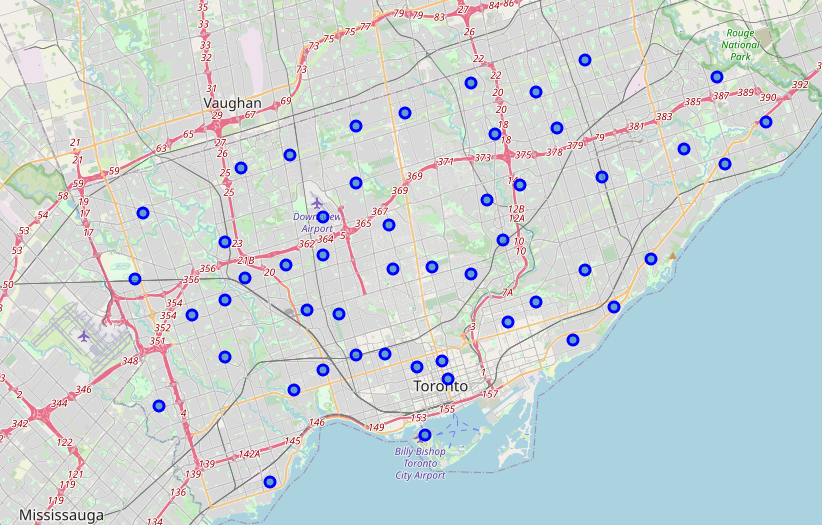

**4. Utilizing the Foursquare API to explore the neighborhoods and segment them.**

In [62]:
# The code was removed by Watson Studio for sharing.

CLIENT_ID = 'QCHWM1U3XUGJZR1OVJ4GYJD4KEQUI4FIECZALX1PNFSXOBJ2' # your Foursquare ID
CLIENT_SECRET = 'TSKC1C05GEJFQSRIU5AY5STP3QOBXRTWFSARYANKVK4SLIKL' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

LIMIT = 100 # limit of number of venues returned by Foursquare API
radius = 500 # define radius


**5. Explore Neighborhoods in Toronto**

In [63]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        #print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [64]:
toronto_venues = getNearbyVenues(names=toronto_all['Neighborhood'],
                                   latitudes=toronto_all['Latitude'],
                                   longitudes=toronto_all['Longitude']
                                  )

toronto_venues.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,"Parkwoods,Parkwoods,Parkwoods-Donalda",43.753259,-79.329656,KFC,43.754387,-79.333021,Fast Food Restaurant
1,"Parkwoods,Parkwoods,Parkwoods-Donalda",43.753259,-79.329656,Brookbanks Park,43.751976,-79.332140,Park
2,"Parkwoods,Parkwoods,Parkwoods-Donalda",43.753259,-79.329656,Variety Store,43.751974,-79.333114,Food & Drink Shop
3,"Lawrence Manor , Lawrence Heights,Briar Hill-B...",43.718518,-79.464763,Roots,43.718214,-79.463893,Boutique
4,"Lawrence Manor , Lawrence Heights,Briar Hill-B...",43.718518,-79.464763,Lac Vien Vietnamese Restaurant,43.721259,-79.468472,Vietnamese Restaurant


**6. Let's check the size of the resulting dataframe**

In [65]:
toronto_venues.shape

(647, 7)

**7. Let's check how many venues were returned for each neighborhood**

In [66]:
toronto_venues.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
"Bathurst Manor , Wilson Heights , Downsview North,Bathurst Manor,Clanton Park,Downsview North,Lansing-Westgate,Wilson Heights",17,17,17,17,17,17
"Bedford Park , Lawrence Manor East,Bedford Park-Nortown,Lawrence Manor East",25,25,25,25,25,25
"Birch Cliff , Cliffside West,Birch Cliff,Birchcliffe-Cliffside,Cliffside West",4,4,4,4,4,4
"CN Tower , King and Spadina , Railway Lands , Harbourfront West , Bathurst Quay , South Niagara , Island airport,Bathurst Quay,Beechborough-Greenbrook,CN Tower,Harbourfront West ,Island airport,King and Spadina,Niagara,Railway Lands,South Niagara,Waterfront Communities-The Island",16,16,16,16,16,16
"Caledonia-Fairbanks,Caledonia Fairbanks,Caledonia-Fairbank,Corso Italia-Davenport,Keelesdale-Eglinton West",4,4,4,4,4,4
"Christie,Christie,Palmerston-Little Italy,Wychwood",15,15,15,15,15,15
"Church and Wellesley,Church and Wellesley,Mount Pleasant East,Mount Pleasant West",67,67,67,67,67,67
"Clairville , Humberwood , Woodbine Downs , West Humber , Kipling Heights , Rexdale , Elms , Tandridge , Old Rexdale,Elms-Old Rexdale,Northwest,Rexdale-Kipling,Steeles,West Humber Clairville",3,3,3,3,3,3
"Clarks Corners , Tam O'Shanter , Sullivan,Clarks Corners,Sullivan,Tam O Shanter,Tam O'Shanter,Tam O'Shanter-Sullivan",14,14,14,14,14,14


**8. Let's find out how many unique categories can be curated from all the returned venues**

In [67]:
print('There are {} uniques categories.'.format(len(toronto_venues['Venue Category'].unique())))

There are 174 uniques categories.


**9. Analyze Each Neighborhood**

In [68]:
# one hot encoding
toronto_onehot_ext = pd.get_dummies(toronto_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
toronto_onehot_ext['Neighborhood'] = toronto_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [toronto_onehot_ext.columns[-1]] + list(toronto_onehot_ext.columns[:-1])
toronto_onehot_ext = toronto_onehot_ext[fixed_columns]

toronto_onehot_ext.head()

,Yoga Studio,Accessories Store,Adult Boutique,Afghan Restaurant,Airport,Airport Food Court,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Art Gallery,Asian Restaurant,Athletics & Sports,Baby Store,Bakery,Bank,Bar,Baseball Field,Basketball Court,Beer Bar,Beer Store,Boat or Ferry,Bookstore,Boutique,Breakfast Spot,Brewery,Bridal Shop,Bubble Tea Shop,Burger Joint,Burrito Place,Bus Line,Bus Station,Business Service,Butcher,Café,Cajun / Creole Restaurant,Candy Store,Caribbean Restaurant,Carpet Store,Chinese Restaurant,Chocolate Shop,Clothing Store,Cocktail Bar,Coffee Shop,College Arts Building,College Gym,College Rec Center,College Stadium,Comfort Food Restaurant,Comic Shop,Construction & Landscaping,Convenience Store,Cosmetics Shop,Curling Ice,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distribution Center,Dog Run,Donut Shop,Drugstore,Electronics Store,Escape Room,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Fish & Chips Shop,Food & Drink Shop,Food Court,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Gas Station,Gastropub,Gay Bar,General Entertainment,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Harbor / Marina,Health Food Store,Hobby Shop,Home Service,Hookah Bar,Hotel,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Intersection,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kitchen Supply Store,Korean BBQ Restaurant,Latin American Restaurant,Light Rail Station,Lingerie Store,Liquor Store,Luggage Store,Medical Center,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Motel,Movie Theater,Music Store,Music Venue,Neighborhood,New American Restaurant,Nightclub,Noodle House,Office,Park,Persian Restaurant,Pet Store,Pharmacy,Pizza Place,Plane,Playground,Plaza,Pool,Post Office,Poutine Place,Pub,Ramen Restaurant,Rental Car Location,Restaurant,Sake Bar,Salon / Barbershop,Sandwich Place,Sculpture Garden,Seafood Restaurant,Shoe Store,Shopping Mall,Skating Rink,Smoke Shop,Spa,Speakeasy,Sporting Goods Shop,Sports Bar,Steakhouse,Strip Club,Supermarket,Supplement Shop,Sushi Restaurant,Tea Room,Thai Restaurant,Theater,Theme Restaurant,Toy / Game Store,Trail,Truck Stop,Vegetarian / Vegan Restaurant,Video Game Store,Video Store,Vietnamese Restaurant,Wine Bar,Wine Shop,Women's Store
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,"Parkwoods,Parkwoods,Parkwoods-Donalda",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,"Parkwoods,Parkwoods,Parkwoods-Donalda",0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,"Parkwoods,Parkwoods,Parkwoods-Donalda",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,"Lawrence Manor , Lawrence Heights,Briar Hill-B...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

**10. Let's examine the new dataframe size.**

In [69]:
toronto_onehot_ext.shape

(647, 174)

**11. Next, let's group rows by neighborhood and by taking the mean of the frequency of occurrence of each category**

In [70]:
toronto_grouped = toronto_onehot_ext.groupby('Neighborhood').mean().reset_index()
toronto_grouped

,Neighborhood,Yoga Studio,Accessories Store,Adult Boutique,Afghan Restaurant,Airport,Airport Food Court,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Art Gallery,Asian Restaurant,Athletics & Sports,Baby Store,Bakery,Bank,Bar,Baseball Field,Basketball Court,Beer Bar,Beer Store,Boat or Ferry,Bookstore,Boutique,Breakfast Spot,Brewery,Bridal Shop,Bubble Tea Shop,Burger Joint,Burrito Place,Bus Line,Bus Station,Business Service,Butcher,Café,Cajun / Creole Restaurant,Candy Store,Caribbean Restaurant,Carpet Store,Chinese Restaurant,Chocolate Shop,Clothing Store,Cocktail Bar,Coffee Shop,College Arts Building,College Gym,College Rec Center,College Stadium,Comfort Food Restaurant,Comic Shop,Construction & Landscaping,Convenience Store,Cosmetics Shop,Curling Ice,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distribution Center,Dog Run,Donut Shop,Drugstore,Electronics Store,Escape Room,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Fish & Chips Shop,Food & Drink Shop,Food Court,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Gas Station,Gastropub,Gay Bar,General Entertainment,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Harbor / Marina,Health Food Store,Hobby Shop,Home Service,Hookah Bar,Hotel,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Intersection,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kitchen Supply Store,Korean BBQ Restaurant,Latin American Restaurant,Light Rail Station,Lingerie Store,Liquor Store,Luggage Store,Medical Center,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Motel,Movie Theater,Music Store,Music Venue,New American Restaurant,Nightclub,Noodle House,Office,Park,Persian Restaurant,Pet Store,Pharmacy,Pizza Place,Plane,Playground,Plaza,Pool,Post Office,Poutine Place,Pub,Ramen Restaurant,Rental Car Location,Restaurant,Sake Bar,Salon / Barbershop,Sandwich Place,Sculpture Garden,Seafood Restaurant,Shoe Store,Shopping Mall,Skating Rink,Smoke Shop,Spa,Speakeasy,Sporting Goods Shop,Sports Bar,Steakhouse,Strip Club,Supermarket,Supplement Shop,Sushi Restaurant,Tea Room,Thai Restaurant,Theater,Theme Restaurant,Toy / Game Store,Trail,Truck Stop,Vegetarian / Vegan Restaurant,Video Game Store,Video Store,Vietnamese Restaurant,Wine Bar,Wine Shop,Women's Store
0,"Bathurst Manor , Wilson Heights , Downsview No...",0.000000,0.0,0.000000,0.000000,0.000000,0.0000,0.000,0.000,0.000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.117647,0.000000,0.000000,0.0,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,0.058824,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.00,0.000000,0.0,0.000000,0.000000,0.000000,0.00,0.117647,0.000000,0.000000,0.00,0.00,0.000000,0.00,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.058824,0.000000,0.00,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.058824,0.058824,0.000000,0.0,0.058824,0.000000,0.000000,0.00,0.000000,0.000000,0.00,0.058824,0.000000,0.000000,0.0000,0.000000,0.00,0.000000,0.00,0.000000,0.058824,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.00,0.0,0.000000,0.000000,0.0000,0.00,0.000000,0.000000,0.00,0.000000,0.000000,0.000000,0.058824,0.058824,0.0000,0.000000,0.00,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,0.058824,0.000000,0.000000,0.058824,0.0000,0.000000,0.000000,0.058824,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.058824,0.00,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.000000,0.00
1,"Bedford Park , Lawrence Manor East,Bedfo

**12. Add columns with school score, crimes and avg house price**

In [71]:
toronto_grouped_k_means = pd.merge(toronto_grouped,
                 toronto_onehot_old[['Neighborhood','Number of all crimes 2014 - 2020','School Score 2018-2019','Average sale price - now']],
                 on='Neighborhood')
toronto_grouped_k_means.head() # check the last columns!


,Neighborhood,Yoga Studio,Accessories Store,Adult Boutique,Afghan Restaurant,Airport,Airport Food Court,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Art Gallery,Asian Restaurant,Athletics & Sports,Baby Store,Bakery,Bank,Bar,Baseball Field,Basketball Court,Beer Bar,Beer Store,Boat or Ferry,Bookstore,Boutique,Breakfast Spot,Brewery,Bridal Shop,Bubble Tea Shop,Burger Joint,Burrito Place,Bus Line,Bus Station,Business Service,Butcher,Café,Cajun / Creole Restaurant,Candy Store,Caribbean Restaurant,Carpet Store,Chinese Restaurant,Chocolate Shop,Clothing Store,Cocktail Bar,Coffee Shop,College Arts Building,College Gym,College Rec Center,College Stadium,Comfort Food Restaurant,Comic Shop,Construction & Landscaping,Convenience Store,Cosmetics Shop,Curling Ice,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distribution Center,Dog Run,Donut Shop,Drugstore,Electronics Store,Escape Room,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Fish & Chips Shop,Food & Drink Shop,Food Court,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Gas Station,Gastropub,Gay Bar,General Entertainment,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Harbor / Marina,Health Food Store,Hobby Shop,Home Service,Hookah Bar,Hotel,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Intersection,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kitchen Supply Store,Korean BBQ Restaurant,Latin American Restaurant,Light Rail Station,Lingerie Store,Liquor Store,Luggage Store,Medical Center,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Motel,Movie Theater,Music Store,Music Venue,New American Restaurant,Nightclub,Noodle House,Office,Park,Persian Restaurant,Pet Store,Pharmacy,Pizza Place,Plane,Playground,Plaza,Pool,Post Office,Poutine Place,Pub,Ramen Restaurant,Rental Car Location,Restaurant,Sake Bar,Salon / Barbershop,Sandwich Place,Sculpture Garden,Seafood Restaurant,Shoe Store,Shopping Mall,Skating Rink,Smoke Shop,Spa,Speakeasy,Sporting Goods Shop,Sports Bar,Steakhouse,Strip Club,Supermarket,Supplement Shop,Sushi Restaurant,Tea Room,Thai Restaurant,Theater,Theme Restaurant,Toy / Game Store,Trail,Truck Stop,Vegetarian / Vegan Restaurant,Video Game Store,Video Store,Vietnamese Restaurant,Wine Bar,Wine Shop,Women's Store,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now
0,"Bathurst Manor , Wilson Heights , Downsview No...",0.0,0.0,0.0,0.0,0.0000,0.0000,0.000,0.000,0.000,0.00,0.0,0.0,0.0,0.0,0.0,0.117647,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0,0.0000,0.0,0.0,0.058824,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.117647,0.0,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.058824,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.058824,0.058824,0.0,0.0,0.058824,0.0,0.0,0.00,0.0,0.0,0.00,0.058824,0.0,0.0,0.0000,0.0,0.00,0.0,0.0,0.0,0.058824,0.00,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.058824,0.058824,0.0000,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0000,0.058824,0.0,0.0,0.058824,0.0000,0.0,0.0,0.058824,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.058824,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.925550,0.897727,0.547809
1,"Bedford Park , Lawrence Manor East,Bedford Par...",0.0,0.0,0.0,0.0,0.0000,0.0000,0.000,0.000,0.000,0.04,0.0,0.0,0.0,0.0,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0,0.0000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.04,0.04,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.080000,0.0,0.0,0.0,0.00,0.04,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.04,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.00,0.0,0.0,0.04,0.040000,0.0,0.0,0.0000,0.0,0.04,0.0,0.0,0.0,0.000000,0.04,0.0,0.0,0

**13. Cluster Neighborhoods - run k-means to cluster the neighborhood into 5 clusters.**

In [72]:
# set number of clusters
kclusters = 5

toronto_grouped_clustering_k_means = toronto_grouped_k_means.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(toronto_grouped_clustering_k_means)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([0, 0, 4, 4, 4, 0, 4, 4, 1, 1], dtype=int32)

**14. Now we use Elbow Method using yellowbrick library to analyze the K-Means and get optimum k of the K-Means.**

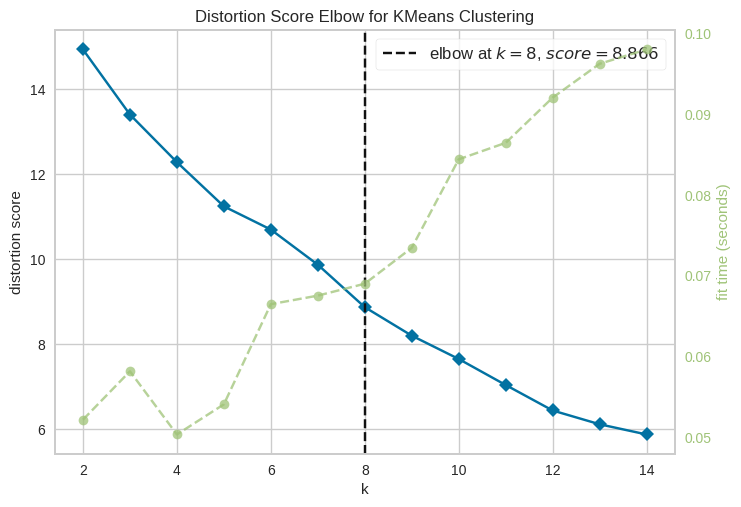

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [73]:
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs

from yellowbrick.cluster import KElbowVisualizer


# Instantiate the clustering model and visualizer
model = KMeans(n_clusters=kclusters, random_state=0).fit(toronto_grouped_clustering_k_means)
visualizer = KElbowVisualizer(model, k=(2,15))

visualizer.fit(toronto_grouped_clustering_k_means)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure


**15. Cluster Neighborhoods - run k-means to cluster the neighborhood into 8 clusters.**

In [74]:
# set number of clusters
kclusters = 8

toronto_grouped_clustering = toronto_grouped_k_means.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(toronto_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([0, 0, 7, 7, 3, 0, 7, 7, 1, 1], dtype=int32)

**16. Let's put that into a pandas dataframe**

In [75]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = toronto_grouped['Neighborhood']

for ind in np.arange(toronto_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(toronto_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,"Bathurst Manor , Wilson Heights , Downsview No...",Coffee Shop,Bank,Pharmacy,Diner,Shopping Mall,Restaurant,Sandwich Place,Ice Cream Shop,Pizza Place,Sushi Restaurant
1,"Bedford Park , Lawrence Manor East,Bedford Par...",Coffee Shop,Pizza Place,Restaurant,Sandwich Place,Hobby Shop,Comfort Food Restaurant,Pet Store,Pharmacy,Café,Butcher
2,"Birch Cliff , Cliffside West,Birch Cliff,Birch...",Skating Rink,General Entertainment,College Stadium,Café,Dance Studio,Distribution Center,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop
3,"CN Tower , King and Spadina , Railway Lands , ...",Airport Terminal,Airport Lounge,Airport Service,Bar,Boat or Ferry,Boutique,Rental Car Location,Plane,Airport Food Court,Airport
4,"Caledonia-Fairbanks,Caledonia Fairbanks,Caledo...",Park,Women's Store,Pool,Cosmetics Shop,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store,Deli / Bodega


**17. Let's create a new dataframe that includes the cluster as well as the top 10 venues for each neighborhood.**

In [76]:
# add clustering labels
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)
neighborhoods_venues_sorted.head()

,Cluster Labels,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,0,"Bathurst Manor , Wilson Heights , Downsview No...",Coffee Shop,Bank,Pharmacy,Diner,Shopping Mall,Restaurant,Sandwich Place,Ice Cream Shop,Pizza Place,Sushi Restaurant
1,0,"Bedford Park , Lawrence Manor East,Bedford Par...",Coffee Shop,Pizza Place,Restaurant,Sandwich Place,Hobby Shop,Comfort Food Restaurant,Pet Store,Pharmacy,Café,Butcher
2,7,"Birch Cliff , Cliffside West,Birch Cliff,Birch...",Skating Rink,General Entertainment,College Stadium,Café,Dance Studio,Distribution Center,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop
3,7,"CN Tower , King and Spadina , Railway Lands , ...",Airport Terminal,Airport Lounge,Airport Service,Bar,Boat or Ferry,Boutique,Rental Car Location,Plane,Airport Food Court,Airport
4,3,"Caledonia-Fairbanks,Caledonia Fairbanks,Caledo...",Park,Women's Store,Pool,Cosmetics Shop,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store,Deli / Bodega


**18. Let's merged all data with clusters, venus and localisation**

In [77]:
toronto_merged = toronto_all

# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
toronto_merged = toronto_merged.join(neighborhoods_venues_sorted.set_index('Neighborhood'), on='Neighborhood')

toronto_merged # check the last columns!

,Postalcode,Borough,Neighborhood,Latitude,Longitude,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,M3A,North York,"Parkwoods,Parkwoods,Parkwoods-Donalda",43.753259,-79.329656,2014.0,6.0,1000000.0,1.0,Park,Fast Food Restaurant,Food & Drink Shop,Women's Store,Dance Studio,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store
1,M6A,North York,"Lawrence Manor , Lawrence Heights,Briar Hill-B...",43.718518,-79.464763,1210.0,3.0,848000.0,7.0,Clothing Store,Furniture / Home Store,Carpet Store,Miscellaneous Shop,Boutique,Sporting Goods Shop,Coffee Shop,Accessories Store,Vietnamese Restaurant,Gastropub
2,M9A,Etobicoke,"Islington Avenue,Edenbridge-Humber Valley,Humb...",43.667856,-79.532242,729.0,7.3,1800000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,M1B,Scarborough,"Malvern , Rouge,Agincourt South-Malvern West,M...",43.806686,-79.194353,3051.0,5.5,707000.0,1.0,Fast Food Restaurant,Women's Store,Donut Shop,Distribution Center,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store,Deli / Bodega
4,M3B,North York,"Don MillsNorth,Banbury-Don Mills,Don Mills",43.745906,-79.352188,1402.0,8.1,1500000.0,0.0,Gym,Athletics & Sports,Baseball Field,Caribbean Restaurant,Café,Japanese Restaurant,Dog Run,Distribution Center,Discount Store,Diner
5,M5B,Downtown Toronto,"Garden District,Church-Yonge Corridor,Garden D...",43.657162,-79.378937,7877.0,9.4,754000.0,2.0,Coffee Shop,Clothing Store,Sandwich Place,Café,Hotel,Bank,Japanese Restaurant,Pizza Place,Cosmetics Shop,Theater
6,M1C,Scarborough,"Rouge Hill , Port Union , Highland Creek,Cente...",43.784535,-79.160497,2448.0,5.9,1300000.0,0.0,Golf Course,Home Service,Bar,Women's Store,Dance Studio,Distribution Center,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop
7,M3C,North York,"Don MillsSouth,Flemingdon Park",43.725900,-79.340923,1375.0,5.9,606000.0,1.0,Gym,Restaurant,Supermarket,Italian Restaurant,Discount Store,Dim Sum Restaurant,Coffee Shop,Clothing Store,Bubble Tea Shop,Sandwich Place
8,M4C,East York,"Woodbine Heights,Danforth,Woodbine Heights,Woo...",43.695344,-79.318389,459.0,5.3,1100000.0,1.0,Beer Store,Athletics & Sports,Curling Ice,Skating Rink,Spa,Park,Video Store,Gas Station,Cosmetics Shop,Diner
9,M9C,Etobicoke,"Eringate , Bloordale Gardens , Old Burnhamthor...",43.643515,-79.577201,518.0,5.5,1000000.0,1.0,Pet Store,Beer Store,Coffee Shop,Pharmacy,Pizza Place,Café,Liquor Store,Park,Frozen Yogurt Shop,Comic Shop


**19.Problems :**<br>
1) because Foursquare API has always updated data - some venus no longer exist, we need check if for some neighborhood there is no available data.If so we must drop that rows.<br> 
2) type of 'Cluster Labels' should be integer                    


In [80]:
toronto_merged = toronto_merged.dropna()
toronto_merged['Cluster Labels'] = toronto_merged['Cluster Labels'].astype(int)
toronto_merged 

,Postalcode,Borough,Neighborhood,Latitude,Longitude,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,M3A,North York,"Parkwoods,Parkwoods,Parkwoods-Donalda",43.753259,-79.329656,2014.0,6.0,1000000.0,1,Park,Fast Food Restaurant,Food & Drink Shop,Women's Store,Dance Studio,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store
1,M6A,North York,"Lawrence Manor , Lawrence Heights,Briar Hill-B...",43.718518,-79.464763,1210.0,3.0,848000.0,7,Clothing Store,Furniture / Home Store,Carpet Store,Miscellaneous Shop,Boutique,Sporting Goods Shop,Coffee Shop,Accessories Store,Vietnamese Restaurant,Gastropub
3,M1B,Scarborough,"Malvern , Rouge,Agincourt South-Malvern West,M...",43.806686,-79.194353,3051.0,5.5,707000.0,1,Fast Food Restaurant,Women's Store,Donut Shop,Distribution Center,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store,Deli / Bodega
4,M3B,North York,"Don MillsNorth,Banbury-Don Mills,Don Mills",43.745906,-79.352188,1402.0,8.1,1500000.0,0,Gym,Athletics & Sports,Baseball Field,Caribbean Restaurant,Café,Japanese Restaurant,Dog Run,Distribution Center,Discount Store,Diner
5,M5B,Downtown Toronto,"Garden District,Church-Yonge Corridor,Garden D...",43.657162,-79.378937,7877.0,9.4,754000.0,2,Coffee Shop,Clothing Store,Sandwich Place,Café,Hotel,Bank,Japanese Restaurant,Pizza Place,Cosmetics Shop,Theater
6,M1C,Scarborough,"Rouge Hill , Port Union , Highland Creek,Cente...",43.784535,-79.160497,2448.0,5.9,1300000.0,0,Golf Course,Home Service,Bar,Women's Store,Dance Studio,Distribution Center,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop
7,M3C,North York,"Don MillsSouth,Flemingdon Park",43.725900,-79.340923,1375.0,5.9,606000.0,1,Gym,Restaurant,Supermarket,Italian Restaurant,Discount Store,Dim Sum Restaurant,Coffee Shop,Clothing Store,Bubble Tea Shop,Sandwich Place
8,M4C,East York,"Woodbine Heights,Danforth,Woodbine Heights,Woo...",43.695344,-79.318389,459.0,5.3,1100000.0,1,Beer Store,Athletics & Sports,Curling Ice,Skating Rink,Spa,Park,Video Store,Gas Station,Cosmetics Shop,Diner
9,M9C,Etobicoke,"Eringate , Bloordale Gardens , Old Burnhamthor...",43.643515,-79.577201,518.0,5.5,1000000.0,1,Pet Store,Beer Store,Coffee Shop,Pharmacy,Pizza Place,Café,Liquor Store,Park,Frozen Yogurt Shop,Comic Shop
10,M1E,Scarborough,"Guildwood , Morningside , West Hill,Guildwood,...",43.763573,-79.188711,1393.0,4.1,820000.0,7,Mexican Restaurant,Rental Car Location,Donut Shop,Medical Center,Electronics Store,Bank,Restaurant,Intersection,Breakfast Spot,Diner


**19. Let's visualize the resulting clusters**

In [81]:
!pip install geopy
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe
address = 'Toronto, ON'

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

geolocator = Nominatim(user_agent="to_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Toronoto are {}, {}.'.format(latitude, longitude))
# create map

# create map of Toronto Neighbourhoods (FSAs) using retrived latitude and longitude values
map_toronto = folium.Map(location=[43.6534817, -79.3839347], zoom_start=11) 
ontario_geo = "Toronto2.geojson"
map_toronto.choropleth(geo_data=ontario_geo,
    data = schools,
    columns=['Post code','Score 2018-2019'],                 
    key_on='feature.properties.CFSAUID',
    fill_color='YlOrRd',
    fill_opacity=0.7, 
    line_opacity=0.7,
    legend_name='Secondary Schools Score 2018-2019' )   
    
#map_toronto




#map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)
# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]



# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(toronto_merged['Latitude'], toronto_merged['Longitude'], toronto_merged['Neighborhood'], toronto_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_toronto)    


    
    
    
map_toronto

DEPRECATION: Python 2.7 reached the end of its life on January 1st, 2020. Please upgrade your Python as Python 2.7 is no longer maintained. pip 21.0 will drop support for Python 2.7 in January 2021. More details about Python 2 support in pip, can be found at https://pip.pypa.io/en/latest/development/release-process/#python-2-support
Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/usr/bin/python -m pip install --upgrade pip' command.
The geograpical coordinate of Toronoto are 43.6534817, -79.3839347.


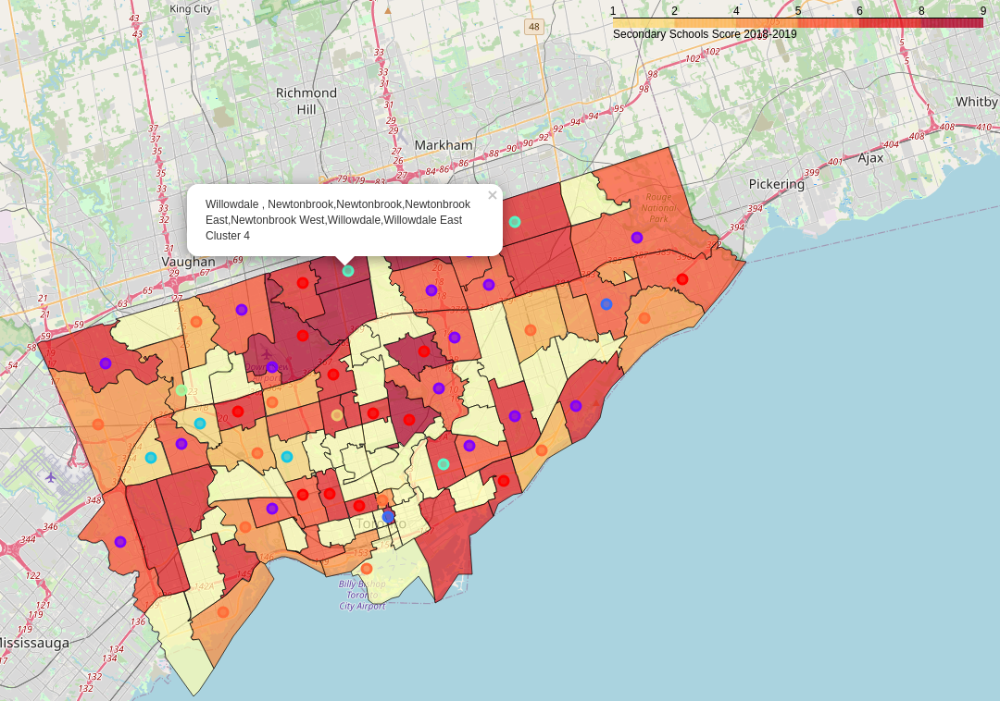

**20. Examine Clusters and determine the discriminating venue categories that distinguish each cluster.**

Cluster 1

In [82]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 0, toronto_merged.columns[[1]+[2] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
4,North York,"Don MillsNorth,Banbury-Don Mills,Don Mills",1402.0,8.1,1500000.0,0,Gym,Athletics & Sports,Baseball Field,Caribbean Restaurant,Café,Japanese Restaurant,Dog Run,Distribution Center,Discount Store,Diner
6,Scarborough,"Rouge Hill , Port Union , Highland Creek,Cente...",2448.0,5.9,1300000.0,0,Golf Course,Home Service,Bar,Women's Store,Dance Studio,Distribution Center,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop
11,East Toronto,"The Beaches,East End-Danforth,The Beaches",2207.0,6.8,1500000.0,0,Coffee Shop,Health Food Store,Pub,Cosmetics Shop,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store,Deli / Bodega
14,East York,"Leaside,Leaside,Leaside-Bennington",732.0,8.7,2000000.0,0,Coffee Shop,Sporting Goods Shop,Burger Joint,Breakfast Spot,Bank,Sushi Restaurant,Supermarket,Pet Store,Mexican Restaurant,Liquor Store
15,Downtown Toronto,"Christie,Christie,Palmerston-Little Italy,Wych...",974.0,7.3,1700000.0,0,Grocery Store,Café,Park,Coffee Shop,Athletics & Sports,Restaurant,Italian Restaurant,Nightclub,Baby Store,Construction & Landscaping
17,North York,"Bathurst Manor , Wilson Heights , Downsview No...",940.0,8.5,1500000.0,0,Coffee Shop,Bank,Pharmacy,Diner,Shopping Mall,Restaurant,Sandwich Place,Ice Cream Shop,Pizza Place,Sushi Restaurant
18,West Toronto,"Dufferin , Dovercourt Village,Dovercourt Villa...",1132.0,6.4,1500000.0,0,Music Venue,Pizza Place,Liquor Store,Smoke Shop,Post Office,Pool,Bar,Bank,Supermarket,Bakery
24,North York,"North Park , Maple Leaf Park , Upwood Park,Map...",453.0,6.9,1200000.0,0,Park,Basketball Court,Trail,Construction & Landscaping,Bakery,Dance Studio,Distribution Center,Discount Store,Diner,Dim Sum Restaurant
27,North York,"Bedford Park , Lawrence Manor East,Bedford Par...",1468.0,6.8,2600000.0,0,Coffee Shop,Pizza Place,Restaurant,Sandwich Place,Hobby Shop,Comfort Food Restaurant,Pet Store,Pharmacy,Café,Butcher
35,Central Toronto,"Davisville North,Davisville North,Yonge-Eglinton",922.0,7.1,1700000.0,0,Dog Run,Hotel,Park,Sandwich Place,Department Store,Food & Drink Shop,Breakfast Spot,Convenience Store,Pizza Place,Gym / Fitness Center


Cluster 2

In [83]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 1, toronto_merged.columns[[1]+[2] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,North York,"Parkwoods,Parkwoods,Parkwoods-Donalda",2014.0,6.0,1000000.0,1,Park,Fast Food Restaurant,Food & Drink Shop,Women's Store,Dance Studio,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store
3,Scarborough,"Malvern , Rouge,Agincourt South-Malvern West,M...",3051.0,5.5,707000.0,1,Fast Food Restaurant,Women's Store,Donut Shop,Distribution Center,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store,Deli / Bodega
7,North York,"Don MillsSouth,Flemingdon Park",1375.0,5.9,606000.0,1,Gym,Restaurant,Supermarket,Italian Restaurant,Discount Store,Dim Sum Restaurant,Coffee Shop,Clothing Store,Bubble Tea Shop,Sandwich Place
8,East York,"Woodbine Heights,Danforth,Woodbine Heights,Woo...",459.0,5.3,1100000.0,1,Beer Store,Athletics & Sports,Curling Ice,Skating Rink,Spa,Park,Video Store,Gas Station,Cosmetics Shop,Diner
9,Etobicoke,"Eringate , Bloordale Gardens , Old Burnhamthor...",518.0,5.5,1000000.0,1,Pet Store,Beer Store,Coffee Shop,Pharmacy,Pizza Place,Café,Liquor Store,Park,Frozen Yogurt Shop,Comic Shop
16,North York,"Hillcrest Village,Bayview Woods-Steeles,Hillcr...",920.0,8.1,898000.0,1,Dog Run,Golf Course,Mediterranean Restaurant,Pool,Fast Food Restaurant,Curling Ice,Diner,Dim Sum Restaurant,Dessert Shop,Department Store
19,North York,"Fairview , Henry Farm , Oriole,Don Valley Vill...",703.0,6.3,1000000.0,1,Clothing Store,Coffee Shop,Fast Food Restaurant,Restaurant,Cosmetics Shop,Bank,Japanese Restaurant,Convenience Store,Bakery,Bus Station
20,North York,"Northwood Park , York University,Northwood Par...",1764.0,6.0,805000.0,1,Coffee Shop,Falafel Restaurant,Caribbean Restaurant,Bar,Furniture / Home Store,Miscellaneous Shop,Dance Studio,Discount Store,Diner,Dim Sum Restaurant
22,North York,"DownsviewEast ,Downsview-Roding-CFB",4654.0,5.6,908000.0,1,Park,Business Service,Airport,Distribution Center,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store,Deli / Bodega
23,Scarborough,"Golden Mile , Clairlea , Oakridge,Clairlea,Cla...",1958.0,7.8,892000.0,1,Bus Line,Bakery,Intersection,Park,Metro Station,Bus Station,Ice Cream Shop,Women's Store,Diner,Dim Sum Restaurant


Cluster 3

In [84]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 2, toronto_merged.columns[[1]+[2] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
5,Downtown Toronto,"Garden District,Church-Yonge Corridor,Garden D...",7877.0,9.4,754000.0,2,Coffee Shop,Clothing Store,Sandwich Place,Café,Hotel,Bank,Japanese Restaurant,Pizza Place,Cosmetics Shop,Theater
13,Scarborough,"Woburn,Woburn",4496.0,5.4,804000.0,2,Coffee Shop,Korean BBQ Restaurant,Donut Shop,Dog Run,Distribution Center,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store


Cluster 4

In [85]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 3, toronto_merged.columns[[1] +[2]+ list(range(5, toronto_merged.shape[1]))]]

,Borough,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
12,York,"Caledonia-Fairbanks,Caledonia Fairbanks,Caledo...",674.0,0.7,1000000.0,3,Park,Women's Store,Pool,Cosmetics Shop,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store,Deli / Bodega
33,York,"Weston,Weston",2309.0,2.0,791000.0,3,Park,Convenience Store,Women's Store,Dance Studio,Distribution Center,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store
39,Etobicoke,"Kingsview Village , St. Phillips , Martin Grov...",1492.0,0.6,1200000.0,3,Park,Bus Line,Sandwich Place,Mobile Phone Shop,College Rec Center,College Stadium,Diner,Dim Sum Restaurant,Dessert Shop,Department Store


Cluster 5

In [86]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 4, toronto_merged.columns[[1] +[2]+ list(range(5, toronto_merged.shape[1]))]]

,Borough,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
21,East York/East Toronto,"The Danforth East,Blake-Jones,Broadview North...",739.0,7.3,1300000.0,4,Park,Metro Station,Convenience Store,Women's Store,Dance Studio,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store
26,North York,"Willowdale , Newtonbrook,Newtonbrook,Newtonbro...",1110.0,8.1,918000.0,4,Park,Women's Store,Curling Ice,Distribution Center,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store,Deli / Bodega
43,Scarborough,"Milliken , Agincourt North , Steeles East , L'...",2108.0,7.5,898000.0,4,Park,Playground,Intersection,Curling Ice,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store,Deli / Bodega


Cluster 6

In [87]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 5, toronto_merged.columns[[1]+[2] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
29,North York,"Humberlea , Emery,Emery,Humberlea,Humbermede,P...",1101.0,4.7,730000.0,5,Baseball Field,Women's Store,Drugstore,Dog Run,Distribution Center,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store


Cluster 7

In [88]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 6 , toronto_merged.columns[[1]+[2] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
32,Central Toronto,"Roselawn,Englemount-Lawrence,Forest Hill North...",1485.0,7.7,2400000.0,6,Home Service,Garden,Women's Store,Curling Ice,Distribution Center,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store


Cluster 8

In [89]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 7 , toronto_merged.columns[[1]+[2] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Neighborhood,Number of all crimes 2014 - 2020,School Score 2018-2019,Average sale price - now,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,North York,"Lawrence Manor , Lawrence Heights,Briar Hill-B...",1210.0,3.0,848000.0,7,Clothing Store,Furniture / Home Store,Carpet Store,Miscellaneous Shop,Boutique,Sporting Goods Shop,Coffee Shop,Accessories Store,Vietnamese Restaurant,Gastropub
10,Scarborough,"Guildwood , Morningside , West Hill,Guildwood,...",1393.0,4.1,820000.0,7,Mexican Restaurant,Rental Car Location,Donut Shop,Medical Center,Electronics Store,Bank,Restaurant,Intersection,Breakfast Spot,Diner
28,York,"Del Ray , Mount Dennis , Keelsdale and Silvert...",1427.0,2.4,725000.0,7,Restaurant,Discount Store,Sandwich Place,Convenience Store,Women's Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store,Deli / Bodega
30,Scarborough,"Birch Cliff , Cliffside West,Birch Cliff,Birch...",1980.0,3.4,1300000.0,7,Skating Rink,General Entertainment,College Stadium,Café,Dance Studio,Distribution Center,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop
31,North York,"DownsviewNorthwest,Black Creek",2727.0,2.4,765000.0,7,Grocery Store,Shopping Mall,Gym / Fitness Center,Discount Store,Dance Studio,Distribution Center,Diner,Dim Sum Restaurant,Dessert Shop,Department Store
34,Scarborough,"Dorset Park , Wexford Heights , Scarborough To...",2473.0,3.1,691000.0,7,Indian Restaurant,Pet Store,Furniture / Home Store,Chinese Restaurant,Light Rail Station,Vietnamese Restaurant,Gastropub,Convenience Store,Dim Sum Restaurant,Dessert Shop
41,West Toronto,"Runnymede , Swansea,Kingsway South,Lambton Bab...",382.0,3.9,1500000.0,7,Coffee Shop,Sushi Restaurant,Pub,Café,Pizza Place,Italian Restaurant,Gym,Health Food Store,Post Office,Latin American Restaurant
44,Downtown Toronto,"CN Tower , King and Spadina , Railway Lands , ...",733.0,4.1,806000.0,7,Airport Terminal,Airport Lounge,Airport Service,Bar,Boat or Ferry,Boutique,Rental Car Location,Plane,Airport Food Court,Airport
45,Etobicoke,"New Toronto , Mimico South , Humber Bay Shores...",875.0,4.1,1100000.0,7,Café,Gym,American Restaurant,Fast Food Restaurant,Liquor Store,Pharmacy,Pizza Place,Restaurant,Seafood Restaurant,Pet Store
48,Etobicoke Northwest,"Clairville , Humberwood , Woodbine Downs , Wes...",920.0,4.1,898000.0,7,Rental Car Location,Drugstore,Truck Stop,Women's Store,Discount Store,Diner,Dim Sum Restaurant,Dessert Shop,Department Store,Deli / Bodega


**21. We see, according to this clustreisation - the most optimum place to settle downo in Toronto woud be neighborhoods from cluster 5.**<br>Secondary schools with high score 7.3 to 8.1 , number of crimes 739 to 2108 , avg hose prices 791000 to 1200000  and  1st Most Common Venue is Park for family with children.